In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from mlxtend.preprocessing import TransactionEncoder
from mlxtend.frequent_patterns import apriori, association_rules
from mlxtend.frequent_patterns import fpgrowth, association_rules

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
/usr/local/lib/python3.10/dist-packages/pexpect/popen_spawn.py:60: DeprecationWarning: setDaemon() is deprecated, set the daemon attribute instead
  self._read_thread.setDaemon(True)


Mounted at /content/drive


# Data Preprocessing

Data Preprocessing has already been executed for you and the preprocessed data is ready for consumption in the Github repository.

Limiting the dataset to 6185 samples

In [ ]:
'''
df_users = pd.read_csv('/content/drive/MyDrive/DTU/CT/Data Science project/BOOK RECOMMENDATION/Users.csv')
df_books = pd.read_csv('/content/drive/MyDrive/DTU/CT/Data Science project/BOOK RECOMMENDATION/Books.csv')

df_books=df_books.iloc[:,:-4]
df_books.head()
'''

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
<ipython-input-4-9d2739b6d64a>:2: DtypeWarning: Columns (3) have mixed types. Specify dtype option on import or set low_memory=False.
  df_books = pd.read_csv('/content/drive/MyDrive/DTU/CT/Data Science project/BOOK RECOMMENDATION/Books.csv')


,ISBN,Book-Title,Book-Author,Year-Of-Publication
0,0195153448,Classical Mythology,Mark P. O. Morford,2002
1,0002005018,Clara Callan,Richard Bruce Wright,2001
2,0060973129,Decision in Normandy,Carlo D'Este,1991
3,0374157065,Flu: The Story of the Great Influenza Pandemic...,Gina Bari Kolata,1999
4,0393045218,The Mummies of Urumchi,E. J. W. Barber,1999


In [ ]:
'''
unique_ISBN=list(df_books['ISBN'].unique())
len(unique_ISBN)
'''

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


271360

In [ ]:
'''
df_books = df_books[df_books['ISBN'].isin(unique_ISBN)]
df_books = df_books.sample(frac=1).reset_index(drop=True)
len(df_books)
'''

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


271360

To enhance the depth and quality of our dataset, we performed a targeted retrieval of additional bibliographic details for a randomly selected subset of books. This extra information was extracted through the Google Books API, which allowed us to supplement our records with a wealth of metadata, including titles, subtitles, authors, publication dates, descriptions, page counts, categories, and language specifications.

In [ ]:
'''
import requests
import pandas as pd
import os

def get_book_details(isbn):
    """ Fetch book details from Google Books API using ISBN. """
    url = f'https://www.googleapis.com/books/v1/volumes?q=isbn:{isbn}'
    response = requests.get(url)
    if response.status_code == 200:
        results = response.json()
        if results.get('totalItems', 0) > 0:
            book = results['items'][0]['volumeInfo']
            return {
                'isbn': isbn,
                'title': book.get('title', ''),
                'subtitle': book.get('subtitle', ''),
                'authors': ', '.join(book.get('authors', [])),
                'publisher': book.get('publisher', ''),
                'publishedDate': book.get('publishedDate', ''),
                'description': book.get('description', ''),
                'pageCount': book.get('pageCount', 0),
                'categories': ', '.join(book.get('categories', [])),
                'language': book.get('language', '')
            }
    return {}

# Lists to store extracted information
details_list = []
count = 0
excel_path = "/content/drive/MyDrive/DTU/CT/Data Science project/BOOK RECOMMENDATION/BOOKFINAL2.csv"

for isbn in df_books['ISBN']:
    book_details = get_book_details(isbn)
    if book_details and book_details['description'] and book_details['language'] == 'en':
        details_list.append(book_details)
        count += 1
        if count % 100 == 0:
            # Check if the file exists
            file_existsh = os.path.isfile(excel_path)
            temp_df = pd.DataFrame(details_list)
            # Write to Excel file
            temp_df.to_csv(excel_path, mode='a', header=not file_exists, index=False)
            print(f"Appended {count} books to the Excel file.")
            # Clear the details list for the next batch
            details_list = []

    # Finish the dowload after 685 books
    if len(details_list) >= 6185:
      break

df_books = pd.DataFrame(details_list)
'''

In [ ]:
#df_books.to_excel("/content/drive/MyDrive/DTU/CT/Data Science project/BOOK RECOMMENDATION/BOOKFINAL2.xlsx")

In [ ]:
#df = pd.read_csv('/content/drive/MyDrive/DTU/CT/Data Science project/BOOK RECOMMENDATION/Ratings.csv')


In [ ]:
#df = df[df['Book-Rating'] != 0]
#df = df.drop_duplicates(['User-ID', 'ISBN'])

In [ ]:
#df = df.sort_values(by='User-ID')

In [ ]:
#unique_ISBN=list(df_books['isbn'].unique())
#len(unique_ISBN)

In [ ]:
#df = df[df['ISBN'].isin(unique_ISBN)]

In [ ]:
#len(df)

In [ ]:
#df.to_csv("/content/drive/MyDrive/DTU/CT/Data Science project/BOOK RECOMMENDATION/RATINGSFINAL.csv")

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


# Data Visualization

In [ ]:
df = pd.read_csv("https://raw.githubusercontent.com/anbipa/BookRecommenderCT/main/RATINGSFINAL.csv")
df_books = pd.read_csv("https://raw.githubusercontent.com/anbipa/BookRecommenderCT/main/BOOKFINAL2.csv")

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


## Ratings

In [ ]:
df_ratings=df
df_ratings

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,Unnamed: 0,User-ID,ISBN,Book-Rating
0,9591,16,0345402871,9
1,9594,17,0425099148,7
2,9608,26,0449005615,9
3,9607,26,0446310786,10
4,9616,39,0553582909,8
...,...,...,...,...
66077,9463,278843,014028009X,8
66078,9521,278844,0679781587,7
66079,9548,278851,1558531025,8
66080,9536,278851,0440486599,5


In [ ]:
df_ratings

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,Unnamed: 0,User-ID,ISBN,Book-Rating
0,9591,16,0345402871,9
1,9594,17,0425099148,7
2,9608,26,0449005615,9
3,9607,26,0446310786,10
4,9616,39,0553582909,8
...,...,...,...,...
66077,9463,278843,014028009X,8
66078,9521,278844,0679781587,7
66079,9548,278851,1558531025,8
66080,9536,278851,0440486599,5


In [ ]:
df_ratings.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 66082 entries, 0 to 66081
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   Unnamed: 0   66082 non-null  int64 
 1   User-ID      66082 non-null  int64 
 2   ISBN         66082 non-null  object
 3   Book-Rating  66082 non-null  int64 
dtypes: int64(3), object(1)
memory usage: 2.0+ MB


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


The dataset has a total of 66082 ratings. The information is organized into three columns: 'User-ID,' representing quantitative attributes in the form of user identifiers; 'ISBN,' a qualitative column containing identification codes for books; and 'Book-Rating,' another quantitative column recording ratings given to the books.

In [ ]:
df_ratings.drop(columns='Unnamed: 0', inplace=True)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
df_ratings.describe().T

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,count,mean,std,min,25%,50%,75%,max
User-ID,66082.0,137380.074423,80573.603712,16.0,67840.0,135149.0,208509.25,278854.0
Book-Rating,66082.0,7.781030,1.792506,1.0,7.0,8.0,9.00,10.0


The provided statistics reveal a distribution of ratings that is notably skewed towards higher values, with a mean rating of approximately 7.78, close to the upper limit of the 1 to 10 scale. The low standard deviation of 1.79 indicates limited variability in ratings, suggesting a concentration around the mean. The fact that 25% of ratings fall at 7 or lower (25th percentile), and the median is 8.0, reflecting that half of the ratings are 8 or lower, signifies a scarcity of low ratings. This distribution suggests a bias towards positive ratings, a phenomenon common in recommendation systems and user-generated content platforms where users tend to rate items they enjoyed more positively. Recognizing this rating pattern is essential for interpreting user sentiment and satisfaction levels within the dataset.

In [ ]:
unique_user_ids = df_ratings['User-ID'].nunique()

print("Number of Unique Users:", unique_user_ids)

Number of Unique Users: 24933


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


### Distribution of numerical variables

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


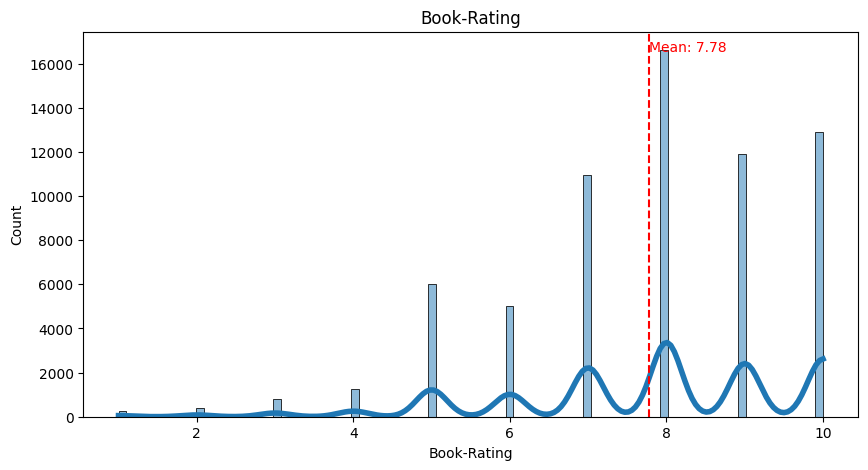

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Specify the column for 'rating'
column_to_plot = 'Book-Rating'

# Convert 'rating' to numeric, coerce non-numeric values to NaN
df_ratings[column_to_plot] = pd.to_numeric(df_ratings[column_to_plot], errors='coerce')

# Drop rows with NaN values in 'rating'
df_ratings = df_ratings.dropna(subset=[column_to_plot])

# Create a histogram for the specified column
plt.figure(figsize=(10, 5))
sns.histplot(df_ratings[column_to_plot], kde=True, line_kws={'linewidth': 4, 'color': 'red'})
plt.title(column_to_plot)

# Add mean line and annotation
mean_val = df_ratings[column_to_plot].mean()
plt.axvline(mean_val, color='red', linestyle='--')
plt.text(mean_val, 0.95 * plt.ylim()[1], f'Mean: {mean_val:.2f}', color='red')

plt.show()


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


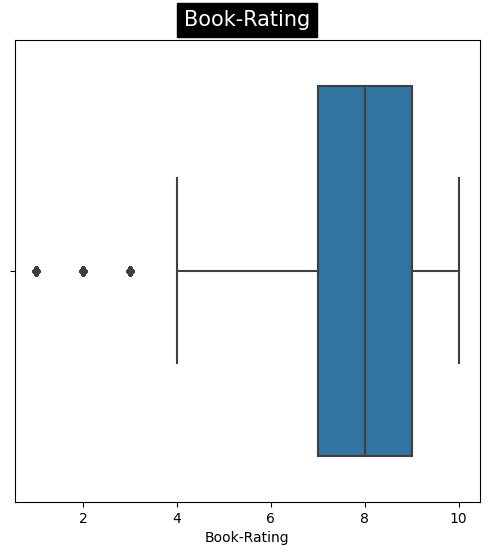

In [ ]:
fig, ax = plt.subplots(figsize=(6, 6))

# Create a boxplot for the 'Rating' column
sns.boxplot(data=df_ratings, x='Book-Rating', ax=ax)
ax.set_title('Book-Rating', backgroundcolor='black', color='white', fontsize=15, pad=10)

plt.show()

## Books

In [ ]:
df_books

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,isbn,title,subtitle,authors,publisher,publishedDate,description,pageCount,categories,language
0,0884115631,The Shepherd,NaN,Frederick Forsyth,NaN,1960-06-01,A pilot and his plane are saved by a mysteriou...,0,Fiction,en
1,0060175648,Identity,A Novel,Milan Kundera,Harper,1998-04-21,Milan Kundera's Identity translated from the F...,176,Fiction,en
2,0394535383,Pillar of the Sky,A Novel,Cecelia Holland,Alfred a Knopf Incorporated,1985,"Two thousand years ago, at the site of Stonehe...",534,England,en
3,0843114401,Jingle Bear,NaN,Stephen Cosgrove,NaN,1985,When the other bears get ready to hibernate fo...,36,Bears,en
4,0451207408,The Adventurer,NaN,Jaclyn Reding,Signet Book,2002,"While attempting to return a mysterious, legen...",314,Fiction,en
...,...,...,...,...,...,...,...,...,...,...
6268,0425092917,The Accidental Tourist,NaN,Anne Tyler,Berkley,1986,Meet Macon Leary--a travel writer who hates bo...,356,American drama,en
6269,0743439740,Every Breath You Take,"A True Story of Obsession, Revenge, and Murder",Ann Rule,Pocket Books,2002-12-01,America’s #1 true-crime writer fulfills a murd...,0,True Crime,en
6270,0449213943,All Quiet on the Western Front,A Novel,Erich Maria Remarque,Ballantine Books,1982,The masterpiece of the German experience durin...,308,Fiction,en
6271,0446611921,The Millionaires,NaN,Brad Meltzer,Warner Books (NY),2002,"Charlie and Oliver, brothers and bankers at a ...",550,Bank robberies,en


In [ ]:
# Assuming 'isbn' is the current column name
df_books.rename(columns={'isbn': 'ISBN'}, inplace=True)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
unique_user_ids = df_books['ISBN'].nunique()

print("Number of Unique Books:", unique_user_ids)

Number of Unique Books: 6273


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
#keep only the year
df_books['publishedDate'] = df_books['publishedDate'].apply(lambda x: str(x)[:4] if pd.notna(x) else None)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
df_books.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6273 entries, 0 to 6272
Data columns (total 10 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   ISBN           6273 non-null   object
 1   title          6273 non-null   object
 2   subtitle       2005 non-null   object
 3   authors        6216 non-null   object
 4   publisher      5348 non-null   object
 5   publishedDate  6268 non-null   object
 6   description    6273 non-null   object
 7   pageCount      6273 non-null   int64 
 8   categories     6157 non-null   object
 9   language       6273 non-null   object
dtypes: int64(1), object(9)
memory usage: 490.2+ KB


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


### Distribution of numerical variables

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


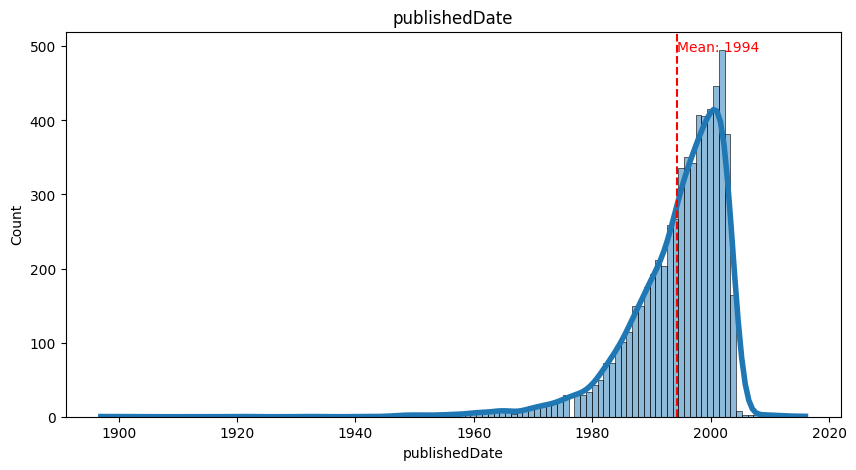

In [ ]:
#published Date
import matplotlib.pyplot as plt
import seaborn as sns

# Specify the column for 'Year-Of-Publication'
column_to_plot = 'publishedDate'

# Convert 'Year-Of-Publication' to numeric, coerce non-numeric values to NaN
df_books[column_to_plot] = pd.to_numeric(df_books[column_to_plot], errors='coerce')

# Drop rows with NaN values in 'Year-Of-Publication'
df_books = df_books.dropna(subset=[column_to_plot])

# Create a histogram for the specified column
plt.figure(figsize=(10, 5))
sns.histplot(df_books[column_to_plot], kde=True, line_kws={'linewidth': 4, 'color': 'red'})
plt.title(column_to_plot)

# Add mean line and annotation
mean_val = df_books[column_to_plot].mean()
plt.axvline(mean_val, color='red', linestyle='--')
plt.text(mean_val, 0.95 * plt.ylim()[1], f'Mean: {mean_val:.0f}', color='red')

plt.show()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


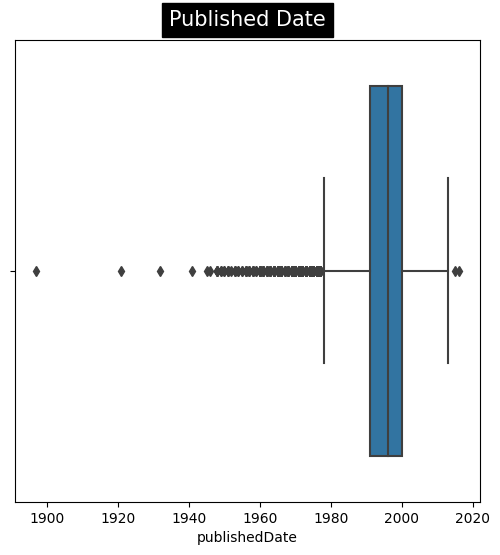

In [ ]:
fig, ax = plt.subplots(figsize=(6, 6))

# Create a boxplot for the 'Rating' column
sns.boxplot(data=df_books, x='publishedDate', ax=ax)
ax.set_title('Published Date', backgroundcolor='black', color='white', fontsize=15, pad=10)

plt.show()

The majority of books in the dataset were published between the years 1980 and 2004.

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
<ipython-input-19-9b67cfad52ff>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_books[column_to_plot] = pd.to_numeric(df_books[column_to_plot], errors='coerce')


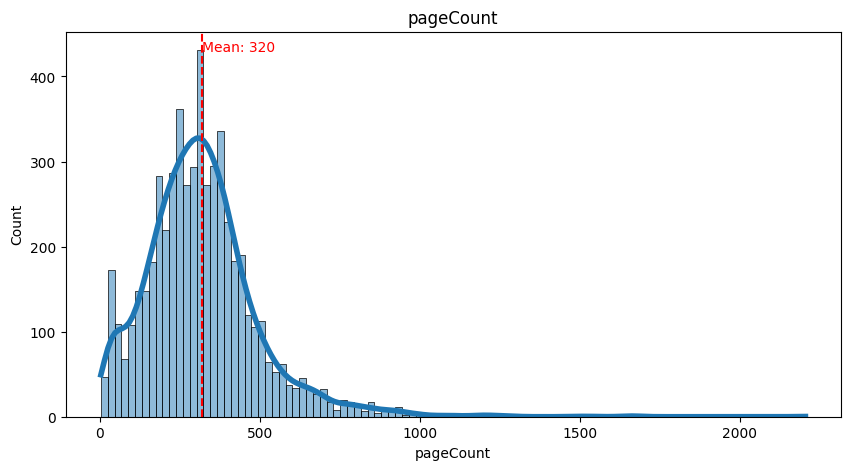

In [ ]:
#pageCount
import matplotlib.pyplot as plt
import seaborn as sns

# Specify the column for 'pageCount'
column_to_plot = 'pageCount'

# Convert 'pageCount' to numeric, coerce non-numeric values to NaN
df_books[column_to_plot] = pd.to_numeric(df_books[column_to_plot], errors='coerce')

# Drop rows with NaN or 0 values in 'pageCount'
df_books = df_books[(df_books[column_to_plot].notna()) & (df_books[column_to_plot] != 0)]

# Create a histogram for the specified column
plt.figure(figsize=(10, 5))
sns.histplot(df_books[column_to_plot], kde=True, line_kws={'linewidth': 4, 'color': 'red'})
plt.title(column_to_plot)

# Add mean line and annotation
mean_val = df_books[column_to_plot].mean()
plt.axvline(mean_val, color='red', linestyle='--')
plt.text(mean_val, 0.95 * plt.ylim()[1], f'Mean: {mean_val:.0f}', color='red')

plt.show()


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


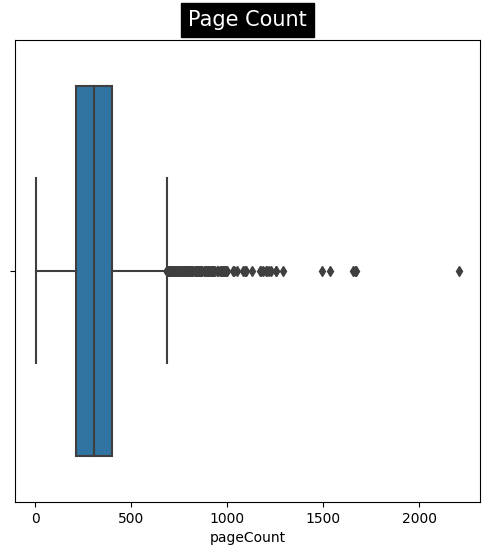

In [ ]:

# Filter out rows with 0 pages
df_books_filtered = df_books[df_books['pageCount'] != 0]

# Create a boxplot for the 'pageCount' column
fig, ax = plt.subplots(figsize=(6, 6))
sns.boxplot(data=df_books_filtered, x='pageCount', ax=ax)
ax.set_title('Page Count', backgroundcolor='black', color='white', fontsize=15, pad=10)

plt.show()


We disregard books with 0 pages as it indicates missing information, and therefore, they are not considered in our analysis. The average page count for the remaining books is 320 pages.

### Distribution of categorical variables

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


The author with the most books is Stephen King with 36 books.


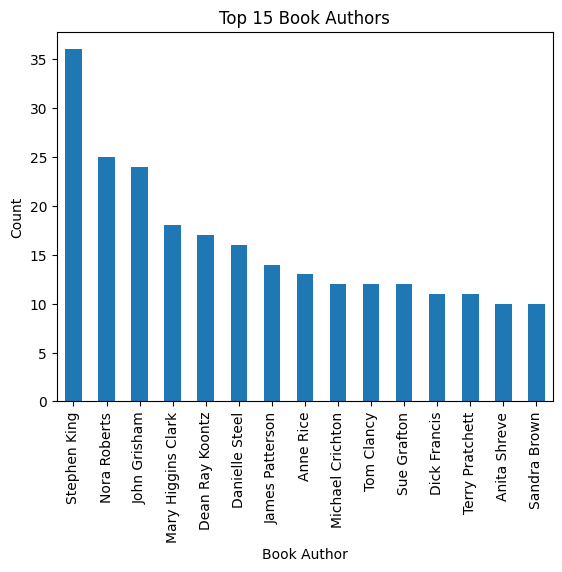

In [ ]:
import matplotlib.pyplot as plt

# Get the value counts for 'authors'
author_counts = df_books['authors'].value_counts()

# Find the author with the most books
most_books_author = author_counts.idxmax()
num_books = author_counts.max()

# Print the result
print(f"The author with the most books is {most_books_author} with {num_books} books.")

# Select the top 15 authors
top_authors = author_counts.head(15)

# Plot the bar chart with X as 'Book Author' and Y as the count
top_authors.plot(kind='bar')

# Labeling the axes
plt.xlabel('Book Author')
plt.ylabel('Count')
plt.title('Top 15 Book Authors')

# Display the plot
plt.show()



/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


The publisher with the most books is Penguin with 168 books.


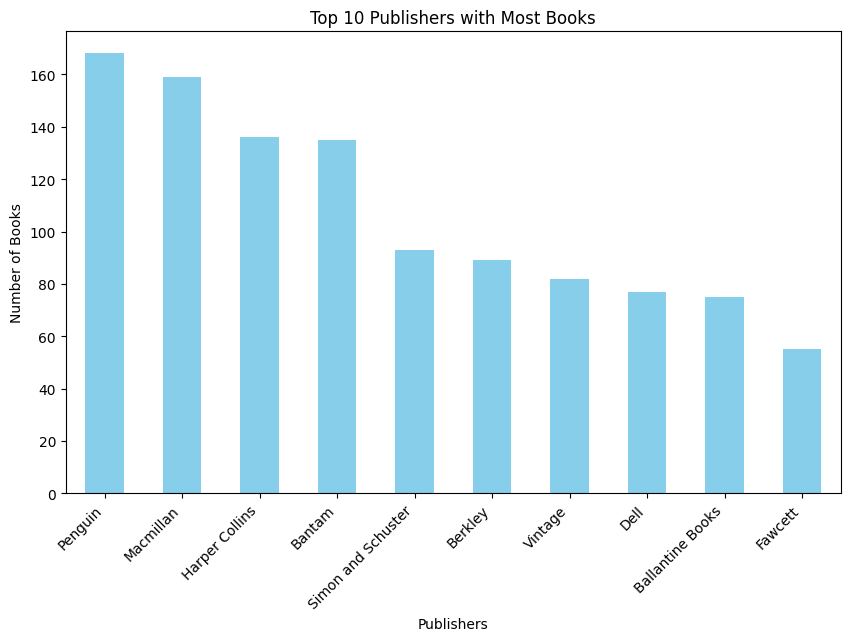

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming df_books is your DataFrame
# Replace 'df_books' with the actual name of your DataFrame if it's different

# Calculate the count of books for each publisher
books_count = df_books['publisher'].value_counts()

# Find the publisher with the most books
most_books_publisher = books_count.idxmax()
num_books = books_count.max()

# Print the result
print(f"The publisher with the most books is {most_books_publisher} with {num_books} books.")

# Sort the publishers based on the number of books in descending order and select the top 10
top_publishers = books_count.sort_values(ascending=False).head(10)

# Plot the data
plt.figure(figsize=(10, 6))
top_publishers.plot(kind='bar', color='skyblue')
plt.title('Top 10 Publishers with Most Books')
plt.xlabel('Publishers')
plt.ylabel('Number of Books')
plt.xticks(rotation=45, ha='right')
plt.show()



/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


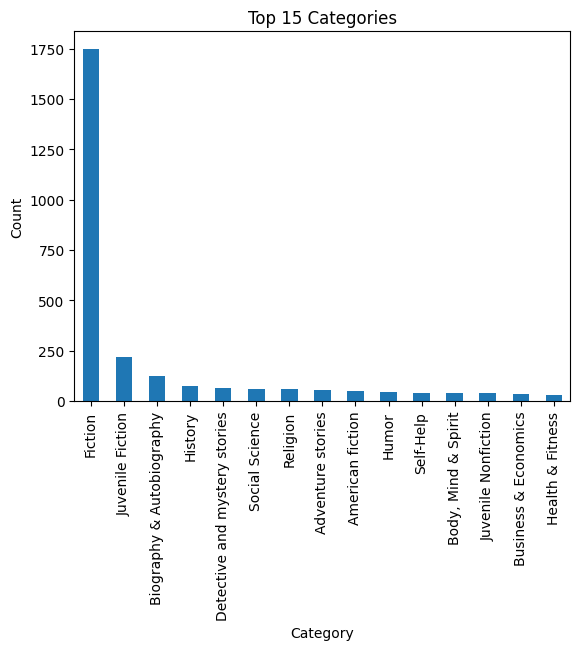

In [ ]:
import matplotlib.pyplot as plt

# Get the value counts for 'Category' and select the top 15
category_counts = df_books['categories'].value_counts().head(15)

# Plot the bar chart with X as 'Category' and Y as the count
category_counts.plot(kind='bar')

# Labeling the axes
plt.xlabel('Category')
plt.ylabel('Count')
plt.title('Top 15 Categories')

# Display the plot
plt.show()

"Fiction" emerges as the most prevalent category in the dataset.

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


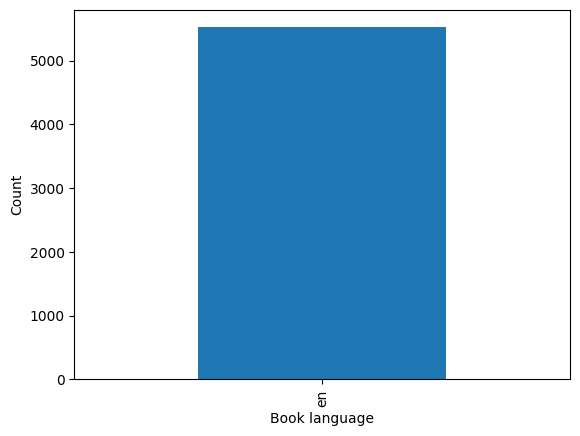

In [ ]:
import matplotlib.pyplot as plt

# Get the value counts for 'Category' and select the top 15
category_counts = df_books['language'].value_counts().head(15)

# Plot the bar chart with X as 'Category' and Y as the count
category_counts.plot(kind='bar')

# Labeling the axes
plt.xlabel('Book language')
plt.ylabel('Count')
# Display the plot
plt.show()

All the books are written in english

## Merging datasets

In [ ]:
#Merging ratings and books dataframes on ISBN
complete_df=df_ratings.merge(df_books, on="ISBN")
print("Merging the 2 dataframes: ratings and books on ISBN")
display(complete_df)

Merging the 2 dataframes: ratings and books on ISBN


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,User-ID,ISBN,Book-Rating,title,subtitle,authors,publisher,publishedDate,description,pageCount,categories,language
0,16,0345402871,9,Airframe,NaN,Michael Crichton,"Random House Digital, Inc.",1996.0,Three passengers are dead. Fifty-six are injur...,443,Fiction,en
1,10215,0345402871,3,Airframe,NaN,Michael Crichton,"Random House Digital, Inc.",1996.0,Three passengers are dead. Fifty-six are injur...,443,Fiction,en
2,14801,0345402871,7,Airframe,NaN,Michael Crichton,"Random House Digital, Inc.",1996.0,Three passengers are dead. Fifty-six are injur...,443,Fiction,en
3,19011,0345402871,9,Airframe,NaN,Michael Crichton,"Random House Digital, Inc.",1996.0,Three passengers are dead. Fifty-six are injur...,443,Fiction,en
4,22463,0345402871,6,Airframe,NaN,Michael Crichton,"Random House Digital, Inc.",1996.0,Three passengers are dead. Fifty-six are injur...,443,Fiction,en
...,...,...,...,...,...,...,...,...,...,...,...,...
61852,276626,0306809044,5,Skywalking,"The Life And Films Of George Lucas, Updated Ed...",Dale Pollock,Da Capo Press,1999.0,Filled with revelations about the origins and ...,362,Performing Arts,en
61853,276664,0140136908,7,A History of Economic Thought,NaN,William J. Barber,Harmondsworth : Penguin,1967.0,The theories and methods of such men as Adam S...,266,Business & Economics,en
61854,277203,0590442899,9,Clifford Goes to Hollywood,NaN,NaN,Cartwheel Books,1980.0,Clifford The Big Red Dog goes to Hollywood--an...,32,Juvenile Fiction,en
61855,277527,0805048782,7,Loving You Was My Undoing,A Novel,Javier Gonzalez-Rubio,Henry Holt and Company,1999.0,No one in Mexico ever imagined the revolution ...,160,Fiction,en


In [ ]:
complete_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 61857 entries, 0 to 61856
Data columns (total 12 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   User-ID        61857 non-null  int64  
 1   ISBN           61857 non-null  object 
 2   Book-Rating    61857 non-null  int64  
 3   title          61857 non-null  object 
 4   subtitle       21036 non-null  object 
 5   authors        61697 non-null  object 
 6   publisher      57737 non-null  object 
 7   publishedDate  61857 non-null  float64
 8   description    61857 non-null  object 
 9   pageCount      61857 non-null  int64  
 10  categories     61815 non-null  object 
 11  language       61857 non-null  object 
dtypes: float64(1), int64(3), object(8)
memory usage: 6.1+ MB


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


### Correlations

Most readed books

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


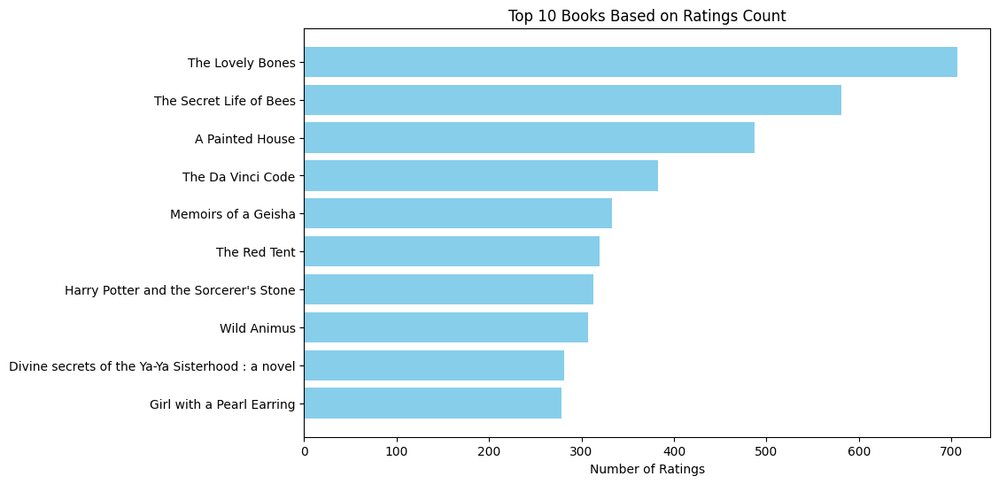

The most rated book in the dataset is 'The Lovely Bones' with 707 ratings.


In [ ]:
import matplotlib.pyplot as plt

# Assuming complete_df is your DataFrame
# Replace 'complete_df' with the actual name of your DataFrame if it's different

# Count the ratings for each book (ISBN)
book_ratings_count = complete_df['ISBN'].value_counts().head(10)

# Extracting data for plotting
top_10_books_count = book_ratings_count.tolist()
top_10_isbns = book_ratings_count.index
top_10_book_titles = list(set(complete_df[complete_df["ISBN"].isin(top_10_isbns)]["title"].tolist()))
top_10_books = dict(zip(top_10_book_titles, top_10_books_count))

# Identify the most read book
most_read_book_title = max(top_10_books, key=top_10_books.get)

# Plotting
plt.figure(figsize=(10, 6))
plt.barh(list(top_10_books.keys()), list(top_10_books.values()), color='skyblue')
plt.xlabel('Number of Ratings')
plt.title('Top 10 Books Based on Ratings Count')
plt.gca().invert_yaxis()  # To display the highest count at the top
plt.show()

print(f"The most rated book in the dataset is '{most_read_book_title}' with {top_10_books[most_read_book_title]} ratings.")



In [ ]:
mean_ratings_count = complete_df['ISBN'].value_counts().mean()

# Display the mean count of ratings
print("Mean Ratings Count for All Books:", mean_ratings_count)

Mean Ratings Count for All Books: 16.682038834951456


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


### Correlation between Book-Rating and the significant attributes

Highly rated books by title

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


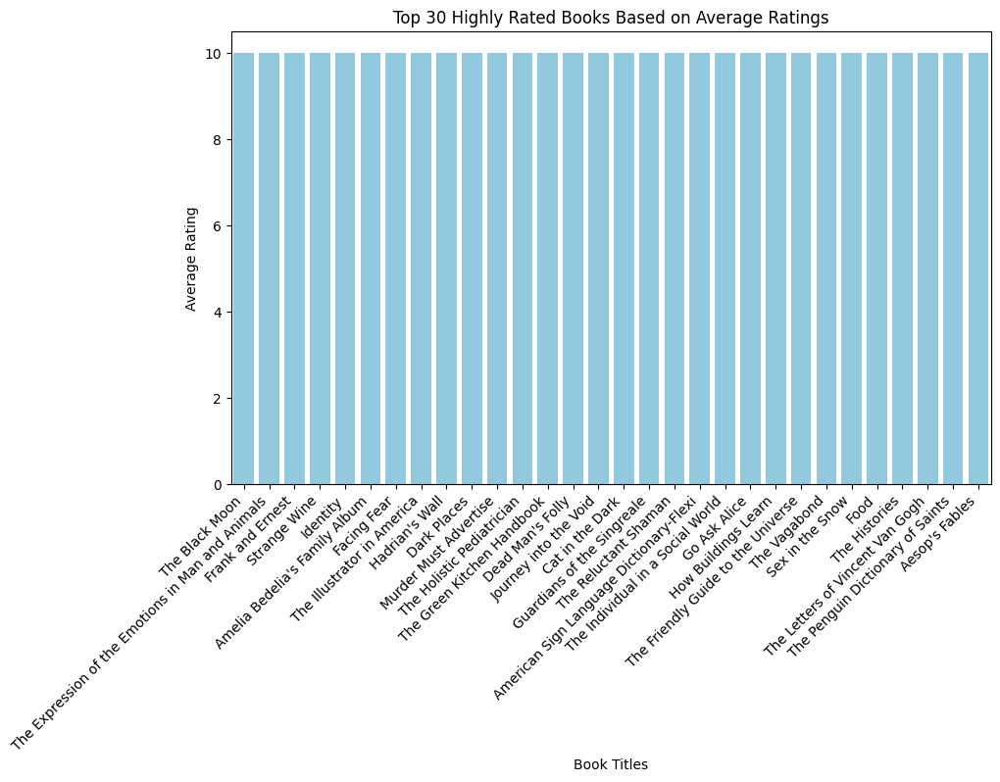

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Calculate the average rating for each book
average_ratings = complete_df.groupby('ISBN')['Book-Rating'].mean()

# Create a DataFrame with ISBN, title, and average rating
books_ratings_df = pd.DataFrame({
    'ISBN': average_ratings.index,
    'title': complete_df.groupby('ISBN')['title'].first(),
    'Average Rating': average_ratings.values
})

# Select the top 10 highly rated books
top_10_highly_rated_books = books_ratings_df.nlargest(30, 'Average Rating')

# Plotting
plt.figure(figsize=(10, 6))
sns.barplot(data=top_10_highly_rated_books, x='title', y='Average Rating', color='skyblue')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better visibility
plt.xlabel('Book Titles')
plt.ylabel('Average Rating')
plt.title('Top 30 Highly Rated Books Based on Average Ratings')
plt.show()


There are a lot of books with only one rating and a 10, those will not be considered. Books with more than 17 votes(the mean)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


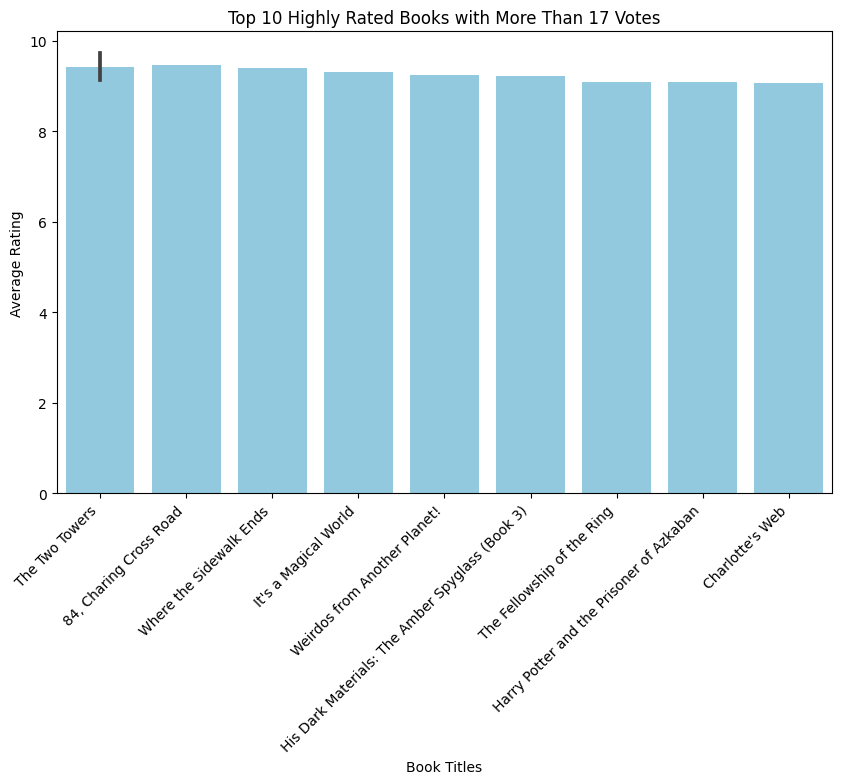

The most highly rated book in the dataset is 'The Two Towers' with an average rating of 9.72.


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Calculate the count of votes for each book
votes_count = complete_df['ISBN'].value_counts()

# Filter books that have more than 12 votes
popular_books_isbn = votes_count[votes_count > 17].index
popular_books_df = complete_df[complete_df['ISBN'].isin(popular_books_isbn)]

# Calculate the average rating for each popular book
average_ratings = popular_books_df.groupby('ISBN')['Book-Rating'].mean()

# Create a DataFrame with ISBN, title, and average rating
popular_books_ratings_df = pd.DataFrame({
    'ISBN': average_ratings.index,
    'title': popular_books_df.groupby('ISBN')['title'].first(),
    'Average Rating': average_ratings.values
})

# Identify the most highly rated book
most_highly_rated_book = popular_books_ratings_df.loc[popular_books_ratings_df['Average Rating'].idxmax()]

# Select the top 10 highly rated books
top_10_highly_rated_books = popular_books_ratings_df.nlargest(10, 'Average Rating')

# Plotting
plt.figure(figsize=(10, 6))
sns.barplot(data=top_10_highly_rated_books, x='title', y='Average Rating', color='skyblue')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better visibility
plt.xlabel('Book Titles')
plt.ylabel('Average Rating')
plt.title('Top 10 Highly Rated Books with More Than 17 Votes')
plt.show()

print(f"The most highly rated book in the dataset is '{most_highly_rated_book['title']}' with an average rating of {most_highly_rated_book['Average Rating']:.2f}.")


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


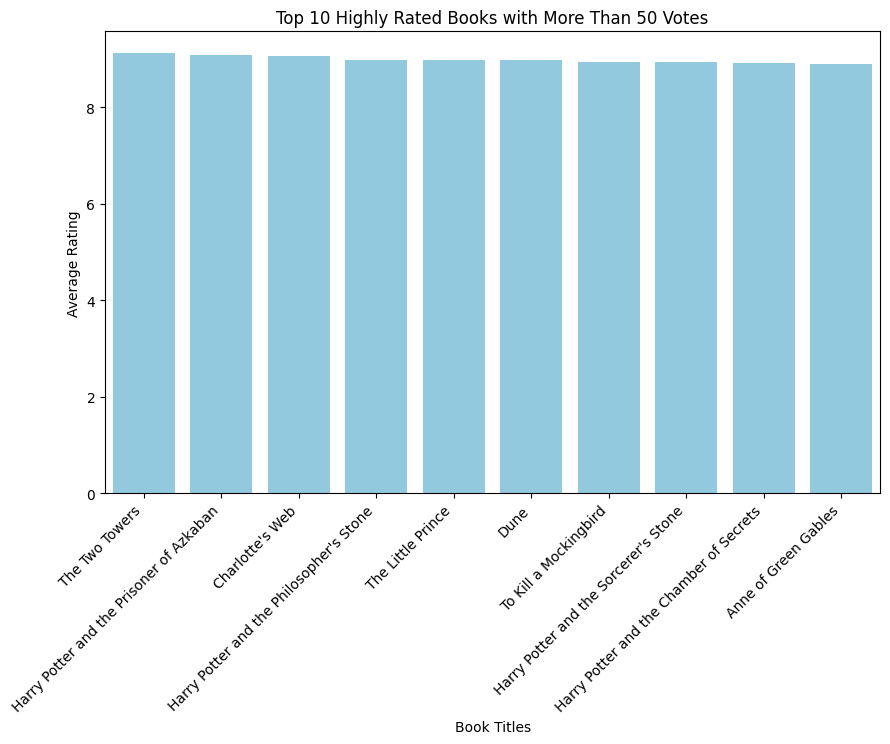

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Calculate the count of votes for each book
votes_count = complete_df['ISBN'].value_counts()

# Filter books that have more than 10 votes
popular_books_isbn = votes_count[votes_count > 50].index
popular_books_df = complete_df[complete_df['ISBN'].isin(popular_books_isbn)]

# Calculate the average rating for each popular book
average_ratings = popular_books_df.groupby('ISBN')['Book-Rating'].mean()

# Create a DataFrame with ISBN, title, and average rating
popular_books_ratings_df = pd.DataFrame({
    'ISBN': average_ratings.index,
    'title': popular_books_df.groupby('ISBN')['title'].first(),
    'Average Rating': average_ratings.values
})

# Select the top 10 highly rated books
top_10_highly_rated_books = popular_books_ratings_df.nlargest(10, 'Average Rating')

# Plotting
plt.figure(figsize=(10, 6))
sns.barplot(data=top_10_highly_rated_books, x='title', y='Average Rating', color='skyblue')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better visibility
plt.xlabel('Book Titles')
plt.ylabel('Average Rating')
plt.title('Top 10 Highly Rated Books with More Than 50 Votes')
plt.show()


### Highly rated authors

In [ ]:
authors_ratings_df = complete_df.groupby('authors')['Book-Rating'].agg(['mean', 'count']).reset_index()

# Find the three most highly rated authors
top_10_highly_rated_authors = authors_ratings_df.nlargest(10, 'mean')

# Print the three most highly rated authors
print("Top 10 Most Highly Rated Authors:")
print(top_10_highly_rated_authors[['authors', 'mean', 'count']])

Top 10 Most Highly Rated Authors:
                    authors  mean  count
4            A. E. van Vogt  10.0      1
6             A. K. Dewdney  10.0      1
7          A. N. Roquelaure  10.0      1
15        Adrian J. Desmond  10.0      1
17  Aesop, Jack David Zipes  10.0      1
20           Ahmed Souaiaia  10.0      1
22          Aileen Humphrey  10.0      1
25     Alan Alexander Milne  10.0      2
48           Alexandra Dirk  10.0      1
64       Alister E. McGrath  10.0      1


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


We will disregard authors who have only one rated book, even if it has the highest rating, as such cases may not be representative.

limiting to authors that have more than 17 ratings(the mean)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


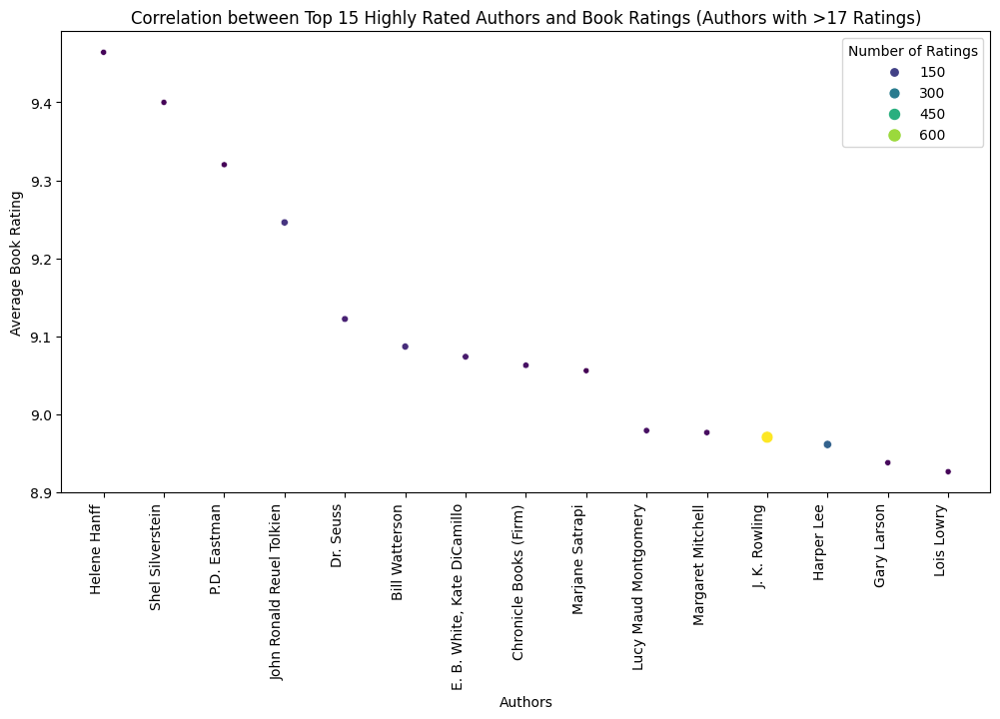

The most highly rated author in the top 15 is 'Helene Hanff' with an average rating of 9.46.


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Calculate the count of ratings for each author
authors_ratings_count = complete_df['authors'].value_counts()

# Filter authors with more than 17 ratings
popular_authors = authors_ratings_count[authors_ratings_count > 17].index
popular_authors_df = complete_df[complete_df['authors'].isin(popular_authors)]

# Create a DataFrame with 'authors', 'Book-Rating', and count of ratings for popular authors
popular_authors_ratings_df = popular_authors_df.groupby('authors')['Book-Rating'].agg(['mean', 'count']).reset_index()

# Identify the top 10 most highly rated authors
top_10_authors = popular_authors_ratings_df.nlargest(15, 'mean')

# Plotting
plt.figure(figsize=(12, 6))

# Scatter plot for the correlation between 'authors' and 'Book-Rating' for top 10 authors
sns.scatterplot(data=top_10_authors, x='authors', y='mean', size='count', hue='count', palette='viridis')
plt.xticks(rotation=90, ha='right')  # Rotate x-axis labels for better visibility
plt.xlabel('Authors')
plt.ylabel('Average Book Rating')
plt.title('Correlation between Top 15 Highly Rated Authors and Book Ratings (Authors with >17 Ratings)')
plt.legend(title='Number of Ratings', loc='upper right')
plt.show()

print(f"The most highly rated author in the top 15 is '{top_10_authors.iloc[0]['authors']}' with an average rating of {top_10_authors.iloc[0]['mean']:.2f}.")


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


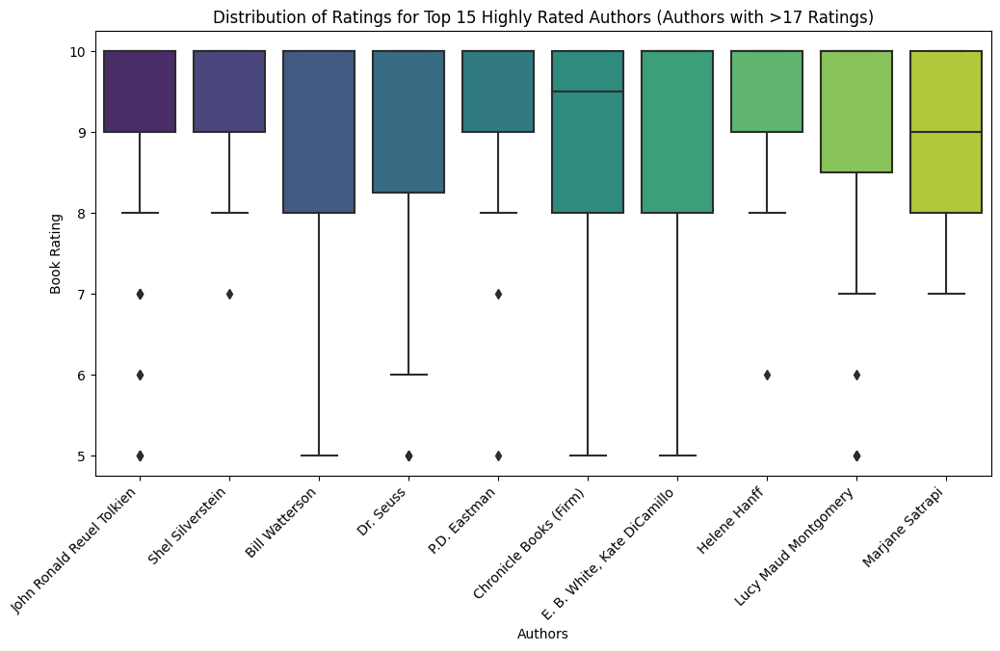

The most highly rated author in the top 10 is 'Helene Hanff' with an average rating of 9.46.


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Calculate the count of ratings for each author
authors_ratings_count = complete_df['authors'].value_counts()

# Filter authors with more than 17 ratings
popular_authors = authors_ratings_count[authors_ratings_count > 17].index
popular_authors_df = complete_df[complete_df['authors'].isin(popular_authors)]

# Create a DataFrame with 'authors', 'Book-Rating', and count of ratings for popular authors
popular_authors_ratings_df = popular_authors_df.groupby('authors')['Book-Rating'].agg(['mean', 'count']).reset_index()

# Identify the top 10 most highly rated authors
top_10_authors = popular_authors_ratings_df.nlargest(10, 'mean')

# Plotting
plt.figure(figsize=(12, 6))

# Boxplot for the distribution of ratings for top 10 authors
sns.boxplot(data=popular_authors_df[popular_authors_df['authors'].isin(top_10_authors['authors'])], x='authors', y='Book-Rating', palette='viridis')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better visibility
plt.xlabel('Authors')
plt.ylabel('Book Rating')
plt.title('Distribution of Ratings for Top 15 Highly Rated Authors (Authors with >17 Ratings)')
plt.show()

print(f"The most highly rated author in the top 10 is '{top_10_authors.iloc[0]['authors']}' with an average rating of {top_10_authors.iloc[0]['mean']:.2f}.")


In [ ]:
top_5_highly_rated_authors = popular_authors_ratings_df.nlargest(5, 'mean')

# Print the three most highly rated authors
print("Top 5 Most Highly Rated Authors:")
print(top_5_highly_rated_authors[['authors', 'mean', 'count']])

Top 5 Most Highly Rated Authors:
                       authors      mean  count
173               Helene Hanff  9.464286     28
425           Shel Silverstein  9.400000     25
355               P.D. Eastman  9.320000     25
238  John Ronald Reuel Tolkien  9.245902    122
122                  Dr. Seuss  9.121951     82


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Distribution of ratings for each popular category

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


The category with the highest mean rating is 'Baggins, Frodo (Fictitious character)' with a mean rating of 9.29


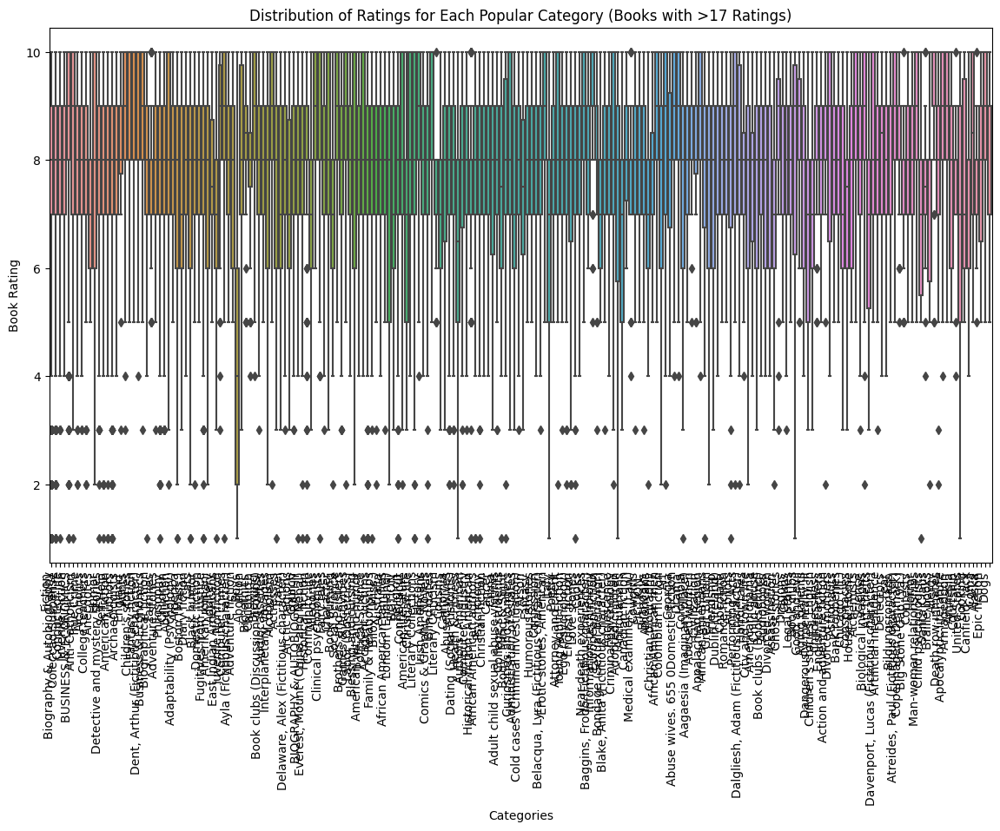

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming complete_df is your DataFrame
# Replace 'complete_df' with the actual name of your DataFrame if it's different

# Filter categories with more than 17 ratings
categories_count = complete_df['categories'].value_counts()
popular_categories = categories_count[categories_count > 17].index
filtered_df = complete_df[complete_df['categories'].isin(popular_categories)]

# Calculate mean ratings for each category
mean_ratings_by_category = filtered_df.groupby('categories')['Book-Rating'].mean()

# Identify the category with the highest mean rating
highest_mean_category = mean_ratings_by_category.idxmax()
highest_mean_value = mean_ratings_by_category.max()

print(f"The category with the highest mean rating is '{highest_mean_category}' with a mean rating of {highest_mean_value:.2f}")

# Box plot to visualize the distribution of ratings for each category
plt.figure(figsize=(14, 8))
sns.boxplot(x='categories', y='Book-Rating', data=filtered_df)
plt.title('Distribution of Ratings for Each Popular Category (Books with >17 Ratings)')
plt.xlabel('Categories')
plt.ylabel('Book Rating')
plt.xticks(rotation=90, ha='right')
plt.show()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


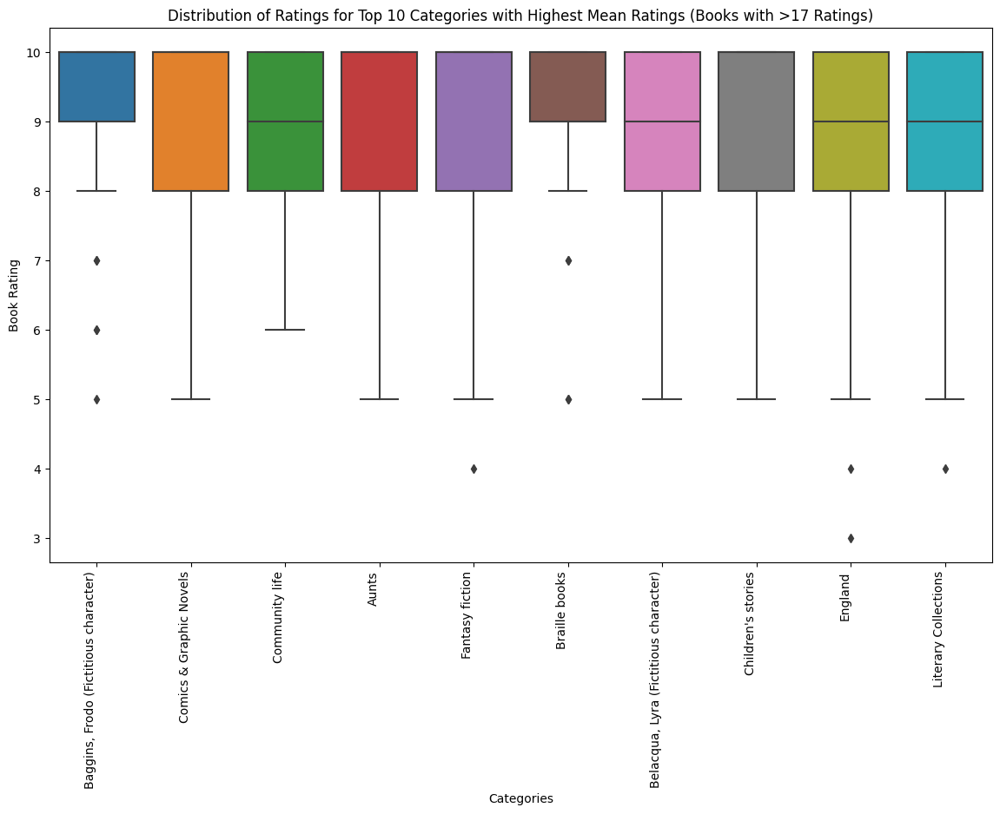

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming complete_df is your DataFrame
# Replace 'complete_df' with the actual name of your DataFrame if it's different

# Filter categories with more than 17 ratings
categories_count = complete_df['categories'].value_counts()
popular_categories = categories_count[categories_count > 17].index
filtered_df = complete_df[complete_df['categories'].isin(popular_categories)]

# Calculate mean ratings for each category
mean_ratings_by_category = filtered_df.groupby('categories')['Book-Rating'].mean()

# Select the top 10 categories with the highest mean rating
top_10_categories = mean_ratings_by_category.nlargest(10)

# Box plot to visualize the distribution of ratings for the top 10 categories
plt.figure(figsize=(14, 8))
sns.boxplot(x='categories', y='Book-Rating', data=filtered_df, order=top_10_categories.index)
plt.title('Distribution of Ratings for Top 10 Categories with Highest Mean Ratings (Books with >17 Ratings)')
plt.xlabel('Categories')
plt.ylabel('Book Rating')
plt.xticks(rotation=90, ha='right')
plt.show()

# Association Rules


Frequent Itemset by Hand with support threshold 0.002

In [ ]:
# Filter and remove duplicates to get liked items (ratings > 6) for each user

df_liked = df[df['Book-Rating'] > 6]
df_liked = df_liked.drop_duplicates(['User-ID', 'ISBN'])
df_liked['User-ID'] = df_liked['User-ID'].astype(str)
df_liked['ISBN'] = df_liked['ISBN'].astype(str)
# Count the number of liked items per user and create baskets of items for each user
baskets = df_liked.groupby('User-ID')['ISBN'].apply(list).tolist()
items = set(list(np.concatenate(baskets).flat))

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
# Create a DataFrame to hash items to integers
df_item_hash = pd.DataFrame(range(len(items)), index=list(items), columns=['hashcode'], dtype=int)

# Count the occurrences of each item and store in an array
item_count_arr = np.zeros((len(items), 1))

for basket in baskets:
    for item in basket:
        idx = df_item_hash.loc[item, 'hashcode']
        item_count_arr[idx] += 1

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
# Find frequent items with support > 0.002 (s1 = 0.002)
freq_items = [df_item_hash[df_item_hash['hashcode'] == x].index[0] for x in np.where(item_count_arr > 0.002 * len(baskets))[0]]


df_freq_item_hash = pd.DataFrame(range(1, len(freq_items) + 1), index=freq_items, columns=['hashcode'])

# Count pairs using only frequent items and store in a matrix (if the itemset is infrequent than superset must be infrequent so does not make sense)
pair_mat_hashed = np.zeros((len(freq_items) + 1, len(freq_items) + 1))

for basket in baskets:
    cand_list = [item for item in basket if item in freq_items]
    if len(cand_list) < 2:
        continue
    for idx, item1 in enumerate(cand_list):
        for item2 in cand_list[idx + 1:]:
            i = df_freq_item_hash.loc[item1, 'hashcode']
            j = df_freq_item_hash.loc[item2, 'hashcode']
            pair_mat_hashed[max(i, j), min(i, j)] += 1


freq_pairs = [
    [df_freq_item_hash[df_freq_item_hash['hashcode'] == x].index[0],
     df_freq_item_hash[df_freq_item_hash['hashcode'] == y].index[0]]
    for x, y in zip(*np.where(pair_mat_hashed > 0.002 * len(baskets)))]

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
print(freq_pairs)

[['0590353403', '0439064864'], ['0439136350', '0439064864'], ['0439136350', '0590353403'], ['0439139597', '0439064864'], ['0439139597', '0590353403'], ['0439139597', '0439136350'], ['0385504209', '0671027360'], ['059035342X', '0439136369'], ['043935806X', '0439064864'], ['043935806X', '0439136350'], ['043935806X', '0439139597']]


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


# Association Rules Algorithms




1. A-priori Support threshold set to 0.003

In [ ]:
# SUPPORT 0.003
from mlxtend.preprocessing import TransactionEncoder
from mlxtend.frequent_patterns import apriori, association_rules
# Convert data to a transactions

df_subset = df_liked
transactions = df_subset.groupby('User-ID')['ISBN'].apply(list).tolist()

# Use TransactionEncoder to convert the data into a binary matrix
te = TransactionEncoder()
te_ary = te.fit(transactions).transform(transactions)
binary_df = pd.DataFrame(te_ary, columns=te.columns_)
# frequent itemsets
frequent_itemsets = apriori(binary_df, min_support=0.003, use_colnames=True)
print("Frequent Itemsets (with more than one element):")
print(frequent_itemsets)


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Frequent Itemsets (with more than one element):
      support                  itemsets
0    0.003189              (0060175400)
1    0.003094              (0060391626)
2    0.005950              (0060392452)
3    0.006283              (0060502258)
4    0.012327              (0060928336)
..        ...                       ...
154  0.003665  (0439064864, 0439136350)
155  0.003141  (0439064864, 0439139597)
156  0.003332  (0439064864, 0590353403)
157  0.003427  (0439139597, 0439136350)
158  0.003046  (0439136350, 0590353403)

[159 rows x 2 columns]


In [ ]:
#min support * transactions
len(transactions)*0.003

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


63.03

In [ ]:
# Generate association rules
rules = association_rules(frequent_itemsets, metric="confidence", min_threshold=0.5)

# Display frequent itemsets and association rules
#print("Frequent Itemsets:")
#print(frequent_itemsets)
print("\nAssociation Rules:")
len(rules)


Association Rules:


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


9

In [ ]:
rules=pd.DataFrame(rules)
rules.head()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,zhangs_metric
0,(0439064864),(0439136350),0.005664,0.006188,0.003665,0.647059,104.574661,0.003630,2.815802,0.996079
1,(0439136350),(0439064864),0.006188,0.005664,0.003665,0.592308,104.574661,0.003630,2.438937,0.996604
2,(0439064864),(0439139597),0.005664,0.006283,0.003141,0.554622,88.277311,0.003106,2.231177,0.994304
3,(0439139597),(0439064864),0.006283,0.005664,0.003141,0.500000,88.277311,0.003106,1.988672,0.994923
4,(0439064864),(0590353403),0.005664,0.005236,0.003332,0.588235,112.352941,0.003302,2.415856,0.996745


2. A-priori support threshold set to 0.001

In [ ]:
# SUPPORT 0.002
# Convert data to transactions

df_subset = df_liked
transactions = df_subset.groupby('User-ID')['ISBN'].apply(list).tolist()

# Use TransactionEncoder to convert the data into a binary matrix
te = TransactionEncoder()
te_ary = te.fit(transactions).transform(transactions)
binary_df = pd.DataFrame(te_ary, columns=te.columns_)
# Use Apriori to find frequent itemsets
frequent_itemsets = apriori(binary_df, min_support=0.002, use_colnames=True)
print("Frequent Itemsets (with more than one element):")
print(frequent_itemsets)


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Frequent Itemsets (with more than one element):
      support                                          itemsets
0    0.002856                                      (002542730X)
1    0.003189                                      (0060175400)
2    0.003094                                      (0060391626)
3    0.005950                                      (0060392452)
4    0.006283                                      (0060502258)
..        ...                                               ...
294  0.002713              (0439064864, 0439139597, 0439136350)
295  0.002808              (0439064864, 0439136350, 0590353403)
296  0.002237              (0439064864, 0439139597, 0590353403)
297  0.002189              (0439139597, 0439136350, 0590353403)
298  0.002094  (0439064864, 0439139597, 0439136350, 0590353403)

[299 rows x 2 columns]


In [ ]:
#min support * transactions
len(transactions)*0.002

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


42.02

In [ ]:
# Generate association rules
rules = association_rules(frequent_itemsets, metric="confidence", min_threshold=0.5)
print("\nAssociation Rules:")
len(rules)


Association Rules:


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


32

3. FP-Growth Algorithm with support threshold set to 0.0005

In [ ]:
# Convert data to a list of lists (transactions)
df_subset = df_liked
transactions = df_subset.groupby('User-ID')['ISBN'].apply(list).tolist()


# Use TransactionEncoder to convert the data into a binary matrix
te = TransactionEncoder()
te_ary = te.fit(transactions).transform(transactions)
binary_df = pd.DataFrame(te_ary, columns=te.columns_)

# Use FP-growth to find frequent itemsets
frequent_itemsets = fpgrowth(binary_df, min_support=0.0005, use_colnames=True)
print("Frequent Itemsets:")
print(frequent_itemsets)


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Frequent Itemsets:
       support                  itemsets
0     0.001475              (0345397819)
1     0.014089              (059035342X)
2     0.005569              (0345339703)
3     0.020419              (0385504209)
4     0.005950              (0060392452)
...        ...                       ...
1623  0.000524  (0553289411, 0553280945)
1624  0.001142  (0515136530, 0515136379)
1625  0.000762  (0552128481, 0552124753)
1626  0.000571  (0552128481, 0552131067)
1627  0.000571  (0552128481, 0552131059)

[1628 rows x 2 columns]


In [ ]:
# Generate association rules
rules_0005 = association_rules(frequent_itemsets, metric="confidence", min_threshold=0.5)

# Display frequent itemsets and association rules
#print("Frequent Itemsets:")
#print(frequent_itemsets)
print("\nAssociation Rules:")
print(len(rules_0005))


Association Rules:
319


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
rules_0005=pd.DataFrame(rules_0005)
rules_0005.head()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,zhangs_metric
0,(0439139597),(0439136350),0.006283,0.006188,0.003427,0.545455,88.153846,0.003388,2.186387,0.994907
1,(0439136350),(0439139597),0.006188,0.006283,0.003427,0.553846,88.153846,0.003388,2.227297,0.994812
2,"(0439139597, 043935806X)",(0439136350),0.002475,0.006188,0.001856,0.750000,121.211538,0.001841,3.975250,0.994211
3,"(043935806X, 0439136350)",(0439139597),0.002427,0.006283,0.001856,0.764706,121.715686,0.001841,4.223298,0.994197
4,"(0439139597, 0439136350)",(043935806X),0.003427,0.009329,0.001856,0.541667,58.063350,0.001824,2.161464,0.986157


# Content Based Recommendation System


In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from sklearn.compose import ColumnTransformer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.preprocessing import StandardScaler
from scipy.cluster.hierarchy import linkage, dendrogram, fcluster
from scipy.spatial.distance import pdist

import matplotlib.pyplot as plt
from sklearn.pipeline import make_pipeline, make_union
import string
from nltk.corpus import stopwords
from sklearn.metrics.pairwise import cosine_similarity

import spacy
import re
import nltk
from nltk.stem import PorterStemmer
from wordcloud import WordCloud
import seaborn as sns
sns.set_style('whitegrid')
nltk.download('stopwords')


[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

Download the csv previously created

In [ ]:
# Loading book information
df_books = pd.read_csv('https://raw.githubusercontent.com/anbipa/BookRecommenderCT/main/BOOKFINAL2.csv')

# Loading reviews information
df_reviews = pd.read_csv('https://raw.githubusercontent.com/anbipa/BookRecommenderCT/main/RATINGSFINAL.csv')

In [ ]:
df_books.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6273 entries, 0 to 6272
Data columns (total 10 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   isbn           6273 non-null   object
 1   title          6273 non-null   object
 2   subtitle       2005 non-null   object
 3   authors        6216 non-null   object
 4   publisher      5348 non-null   object
 5   publishedDate  6268 non-null   object
 6   description    6273 non-null   object
 7   pageCount      6273 non-null   int64 
 8   categories     6157 non-null   object
 9   language       6273 non-null   object
dtypes: int64(1), object(9)
memory usage: 490.2+ KB


In [ ]:
df_reviews.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 66082 entries, 0 to 66081
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   Unnamed: 0   66082 non-null  int64 
 1   User-ID      66082 non-null  int64 
 2   ISBN         66082 non-null  object
 3   Book-Rating  66082 non-null  int64 
dtypes: int64(3), object(1)
memory usage: 2.0+ MB


In this section, we define several functions for text cleaning and preprocessing, that will help us remove unnecessary elements from our text data, such as HTML tags, stopwords, digits, punctuation, and they will also perform stemming. After defining these functions, we combine relevant text fields from the `df_books` dataset into a new `CombinedText` column and apply our text processing functions to this column.


---




In [ ]:
def strip_html(text):
    clean = re.compile('<.*?>')
    return re.sub(clean, '', text)

def remove_stopwords(text):
    text = text.split()
    text = [word for word in text if word not in stopwords]
    return ' '.join(text)

def remove_digits(text):
    text = re.sub(r'[0-9]', '', text)
    return text

def remove_punctuation(text):
    text = ''.join([word for word in text if word not in punctuation])
    return text

def stem_text(text):
    stemmer = PorterStemmer()
    text = ' '.join([stemmer.stem(word) for word in text.split()])
    return text

def parse_text(text):
    text = text.lower()
    text = strip_html(text)
    text = remove_stopwords(text)
    text = remove_digits(text)
    text = remove_punctuation(text)
    text = stem_text(text)
    return text

In [ ]:
df = df_books.copy()

In [ ]:
df['CombinedText'] = (
    df['title'].astype(str).fillna('') + ' ' +
    df['subtitle'].astype(str).fillna('') + ' ' +
    df['authors'].astype(str).fillna('') + ' ' +
    df['description'].astype(str).fillna('') + ' ' +
    df['categories'].astype(str).fillna('')
)

stopwords = set(stopwords.words('english'))
punctuation = string.punctuation + '—'

df['CombinedText'] = df['CombinedText'].apply(parse_text)
df.head()


,isbn,title,subtitle,authors,publisher,publishedDate,description,pageCount,categories,language,CombinedText
0,0884115631,The Shepherd,NaN,Frederick Forsyth,NaN,1960-06-01,A pilot and his plane are saved by a mysteriou...,0,Fiction,en,shepherd nan frederick forsyth pilot plane sav...
1,0060175648,Identity,A Novel,Milan Kundera,Harper,1998-04-21,Milan Kundera's Identity translated from the F...,176,Fiction,en,ident novel milan kundera milan kundera ident ...
2,0394535383,Pillar of the Sky,A Novel,Cecelia Holland,Alfred a Knopf Incorporated,1985,"Two thousand years ago, at the site of Stonehe...",534,England,en,pillar sky novel cecelia holland two thousand ...
3,0843114401,Jingle Bear,NaN,Stephen Cosgrove,NaN,1985,When the other bears get ready to hibernate fo...,36,Bears,en,jingl bear nan stephen cosgrov bear get readi ...
4,0451207408,The Adventurer,NaN,Jaclyn Reding,Signet Book,2002,"While attempting to return a mysterious, legen...",314,Fiction,en,adventur nan jaclyn rede attempt return myster...


We remove the "nan" words from the combined text

In [ ]:
df['CombinedText'] = df['CombinedText'].replace('nan', '', regex=True)

To visually explore the most frequent words in our combined book data, we generate a word cloud, this visualization will help us understand the predominant themes or topics in our dataset.


In [ ]:
def create_wordcloud(data):
    wordcloud = WordCloud(
        width=1500,
        height=800,
        min_font_size=12,
        background_color='white'
    ).generate(data)
    plt.figure(figsize=(15,8))
    plt.imshow(wordcloud)
    plt.axis('off')
    plt.tight_layout(pad=0)
    plt.show()

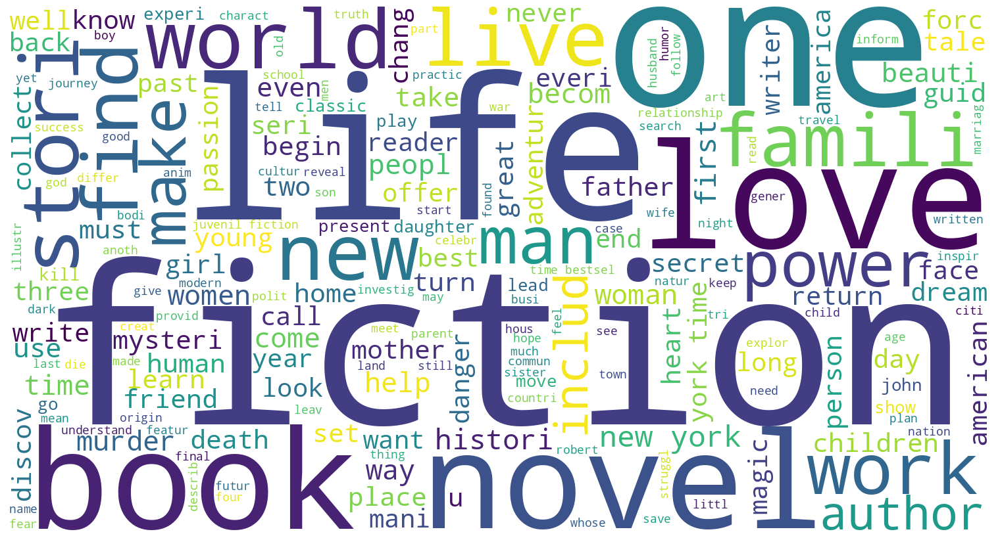

In [ ]:
all_corpus = ' '.join(df['CombinedText'])
create_wordcloud(all_corpus)

### Vectorize text

We transform our cleaned and combined text data into a numerical format using TF-IDF vectorization, to feed the data to the clustering and recommendation algorithms as it converts text into a form that can be processed by machine learning algorithms.

Ignore terms that appear in more than 50% of the documents (as set by max_df=0.5) and terms that are not present in at least 5 documents (set by min_df=5)

In [ ]:
vectorizer = TfidfVectorizer(max_df=0.5,min_df=5)
tfidf = vectorizer.fit_transform(df['CombinedText'])
tfidf

<6273x6762 sparse matrix of type '<class 'numpy.float64'>'
	with 235708 stored elements in Compressed Sparse Row format>

Compute spasity of the matrix as the fraction of non-zero entries divided by the total number of elements

In [ ]:
print(f"{tfidf.nnz / np.prod(tfidf.shape):.3f}")

0.006


# Hierarchical Clustering

first approach. We use pdist to compute the cosine distance between the documents.

In [ ]:
X = tfidf.todense()
dist_array = pdist(X, 'cosine')

In [ ]:
from scipy.spatial.distance import squareform

len(dist_array)
distance_matrix = squareform(dist_array)

Perform hierarchical clustering

First we perform the dendrogram in order to identify the different clusters inside our data


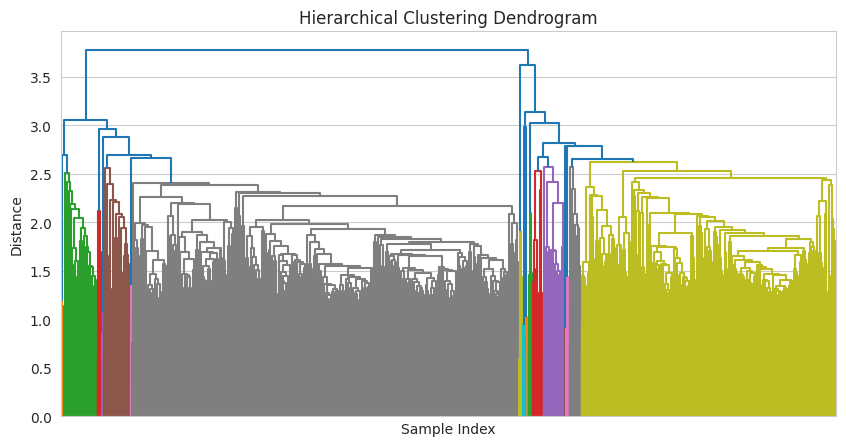

In [ ]:
from scipy.cluster.hierarchy import linkage, dendrogram

# Perform hierarchical clustering
linkage_matrix = linkage(dist_array, method='ward')

plt.figure(figsize=(10, 5))
dendrogram(linkage_matrix, no_labels=True)
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Sample Index')
plt.ylabel('Distance')
plt.show()

We also performed the silhoeutte score from a range from 2 to 30 in order to identify teh quality of the clsuters.

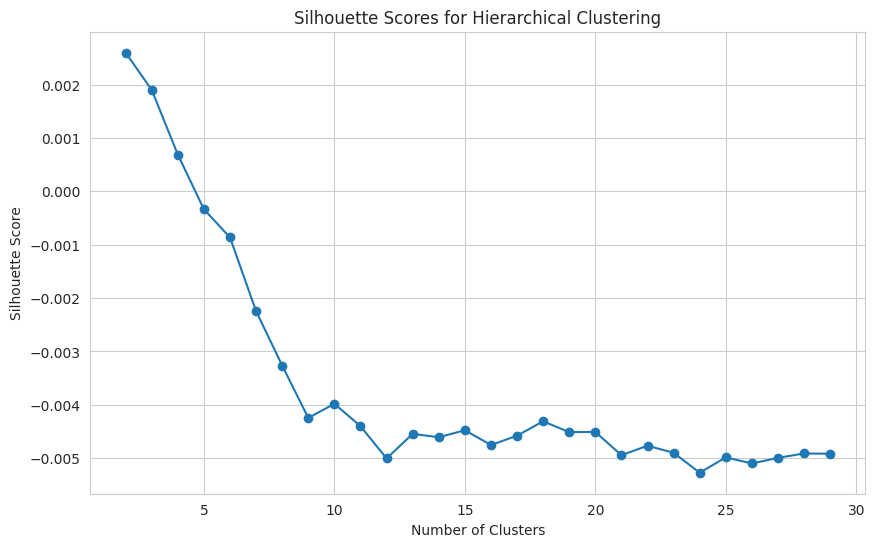

In [ ]:
from sklearn.metrics import silhouette_score

cluster_numbers = range(2, 30)
silhouette_scores_hierarchical = []

for k in cluster_numbers:
    # Extract cluster labels
    cluster_labels = fcluster(linkage_matrix, k, criterion='maxclust')
    # Calculate silhouette score using the X_lsa
    silhouette_avg = silhouette_score(distance_matrix, cluster_labels, metric='precomputed')
    silhouette_scores_hierarchical.append(silhouette_avg)

plt.figure(figsize=(10, 6))
plt.plot(cluster_numbers, silhouette_scores_hierarchical, marker='o')
plt.title('Silhouette Scores for Hierarchical Clustering')
plt.xlabel('Number of Clusters')
plt.ylabel('Silhouette Score')
plt.show()

We select k based on the dendogram visualization and the silhoeutte score

In [ ]:
clusters = fcluster(linkage_matrix, t=12, criterion='maxclust')

# Append cluster labels to the dataframe
df['cluster_h'] = clusters

In [ ]:
# Print the distribution of clusters
cluster_distribution = df['cluster_h'].value_counts().sort_index()
print(cluster_distribution)


1      293
2       39
3       14
4     3362
5       32
6       17
7       29
8       32
9      258
10      11
11      28
12    2158
Name: cluster_h, dtype: int64


Print wordclouds

Upon examining the word clouds generated for each cluster, it becomes evident that certain clusters distinctly encapsulate specific genres or topics, this highlight the effectiveness of the clustering algorithm in discerning and grouping books based on meaningful thematic elements.

CLUSTER NUMBER:  4


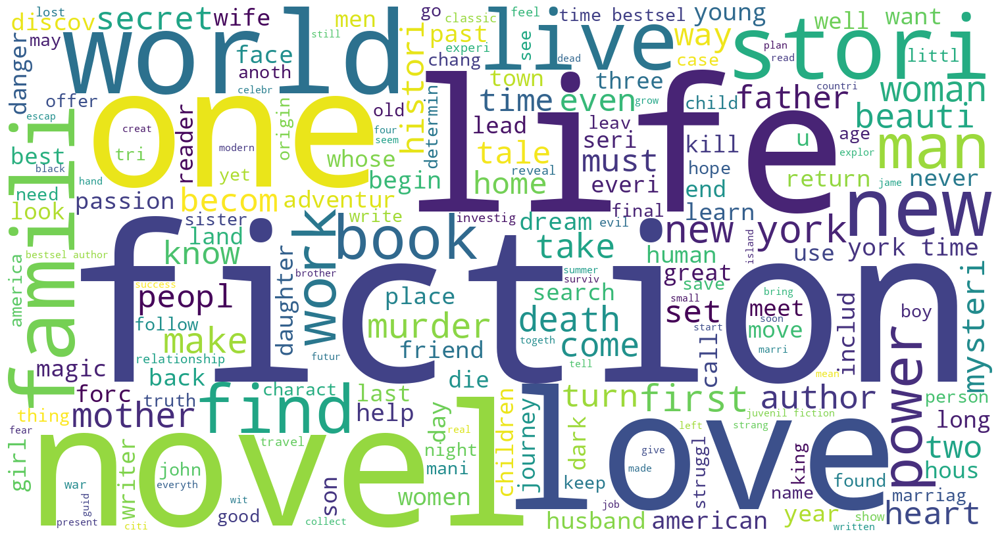

CLUSTER NUMBER:  12


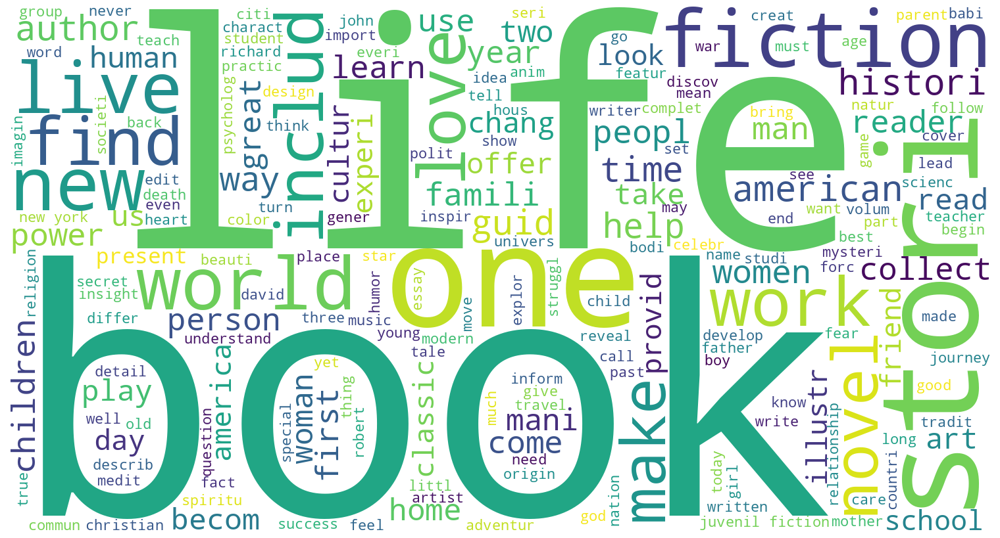

CLUSTER NUMBER:  7


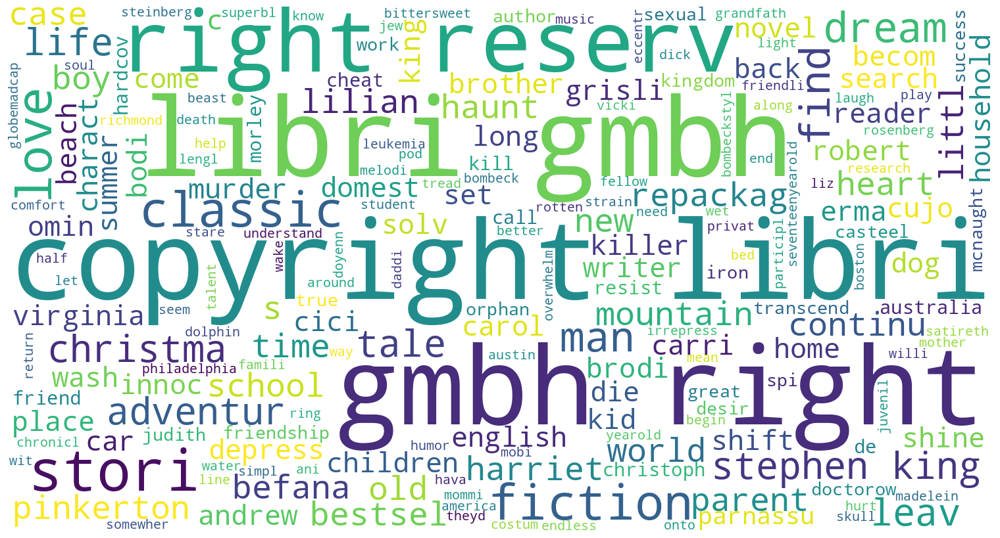

CLUSTER NUMBER:  1


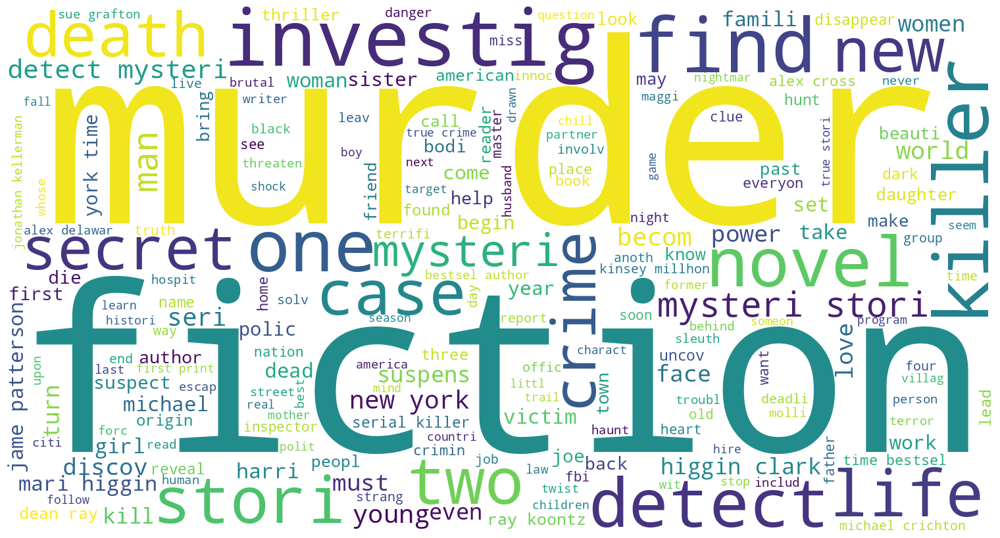

CLUSTER NUMBER:  9


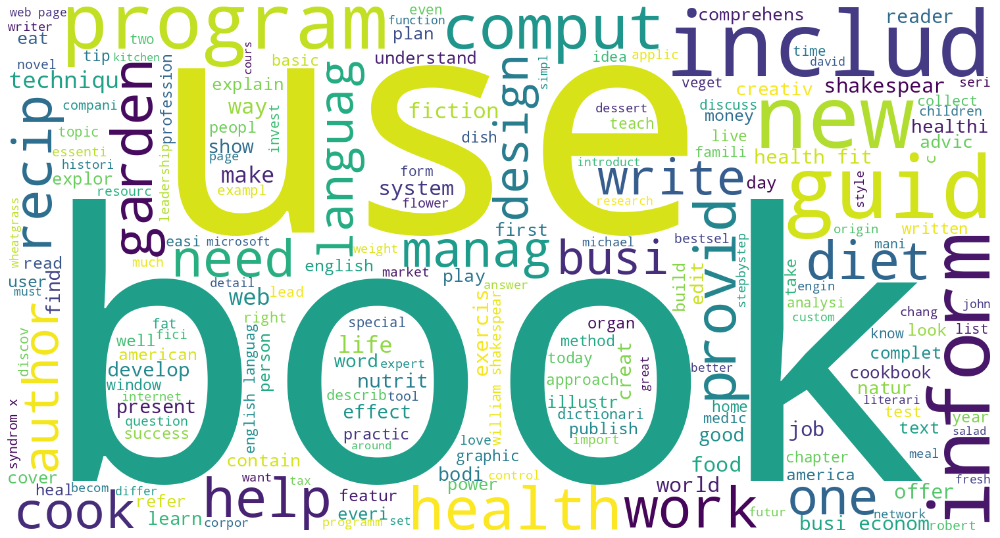

CLUSTER NUMBER:  11


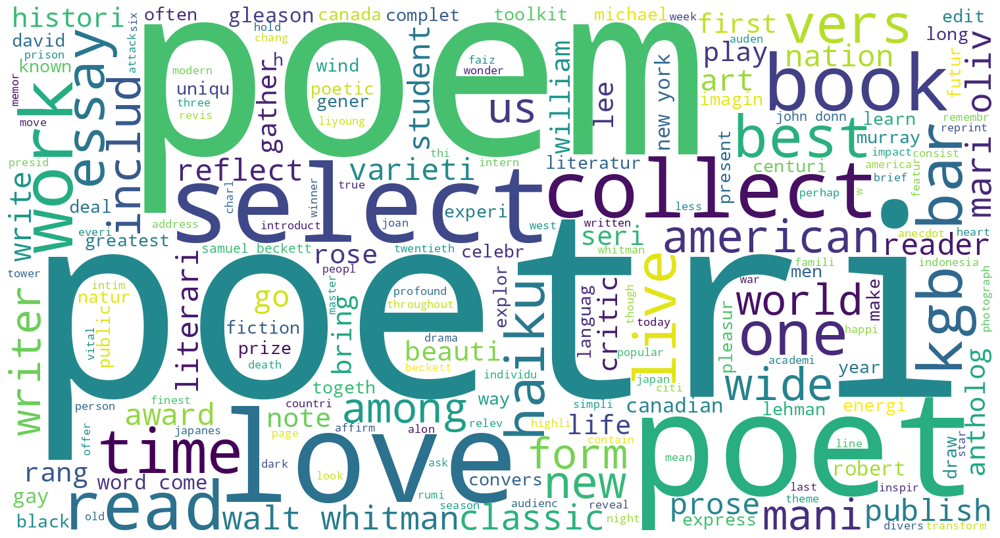

CLUSTER NUMBER:  8


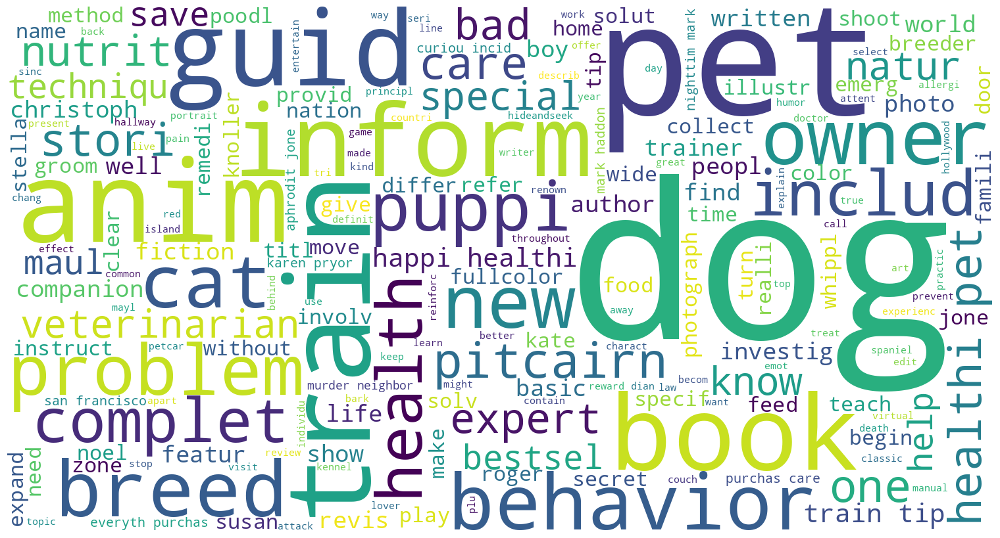

CLUSTER NUMBER:  5


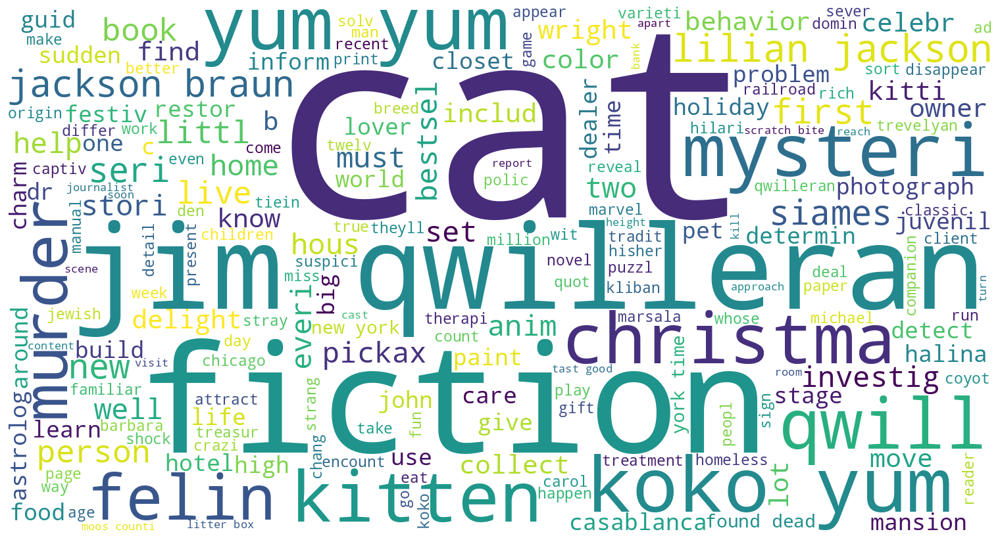

CLUSTER NUMBER:  2


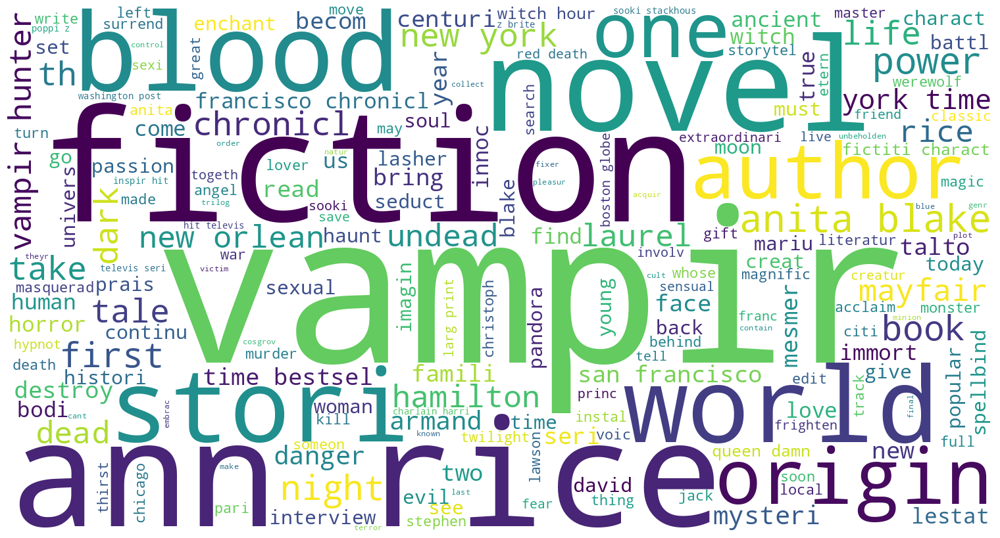

CLUSTER NUMBER:  6


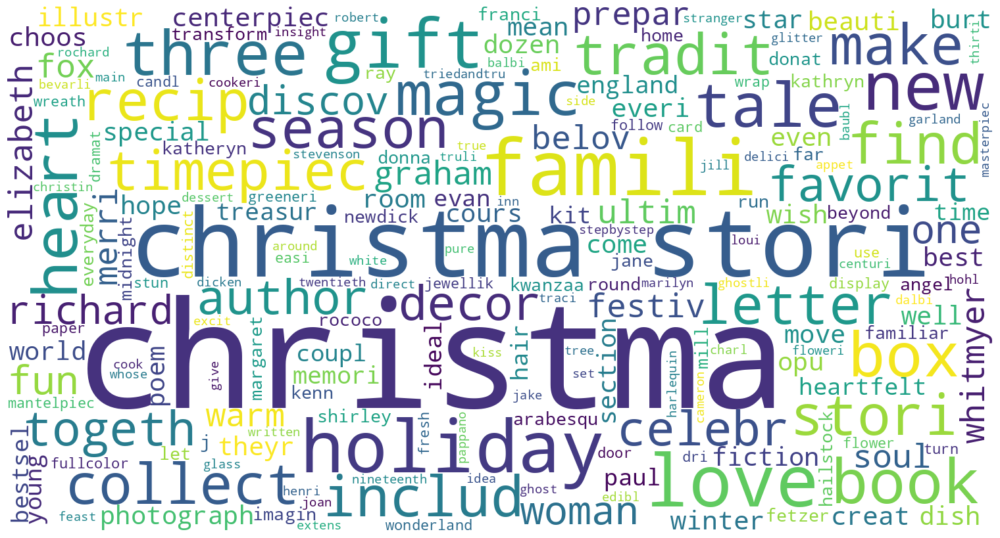

CLUSTER NUMBER:  3


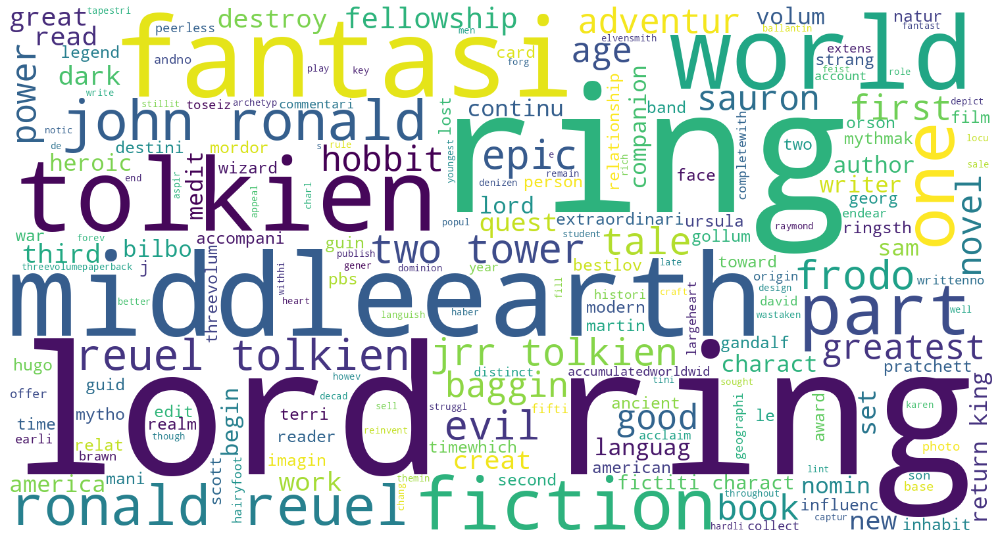

CLUSTER NUMBER:  10


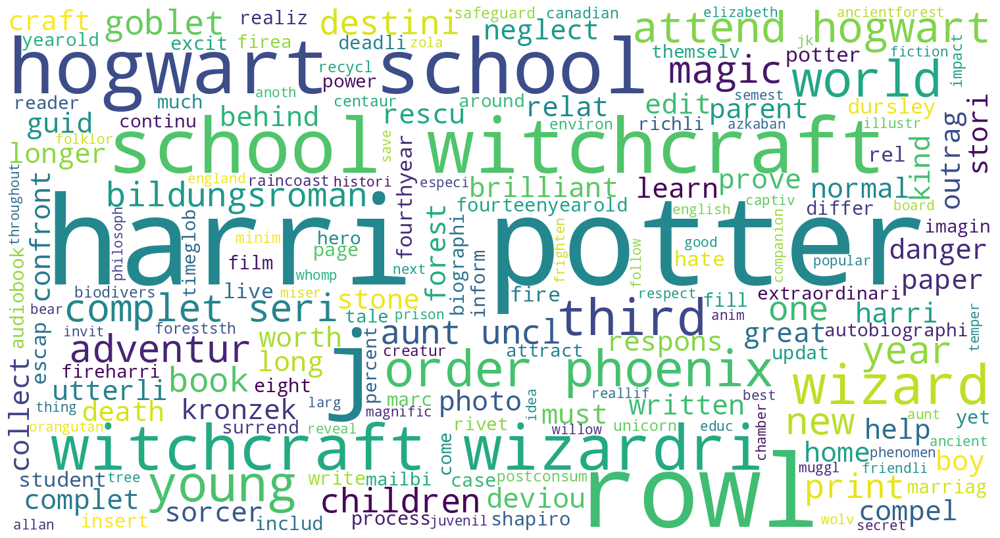

In [ ]:
unique_clusters = df['cluster_h'].unique()

# Create a dictionary to store DataFrames for each cluster
cluster_dataframes = {}

# Split the DataFrame by cluster label
for cluster_label in unique_clusters:
    cluster_dataframes[cluster_label] = df[df['cluster_h'] == cluster_label]
    joined_genre = ' '.join(cluster_dataframes[cluster_label]['CombinedText'])
    print("CLUSTER NUMBER: ", cluster_label)
    create_wordcloud(joined_genre)

## Validation

While the silhouette scores suggest less than optimal clustering results due to their negative values, this does not fully capture the effectiveness of our clustering. Contrary to the silhouette scores, the word clouds generated for individual clusters reveal a different story, the representations show that some clusters do indeed encapsulate distinct and meaningful themes.


In [ ]:
from scipy.spatial.distance import squareform
from sklearn.metrics import silhouette_score


distance_matrix = squareform(dist_array)

silhouette_avg = silhouette_score(distance_matrix, clusters, metric='precomputed')
print(f"Silhouette Score: {silhouette_avg}")

Silhouette Score: -0.005005541642158681


# K-Means


In [ ]:
from sklearn import metrics
def evaluate(km, X):
  print('silhouette: ', metrics.silhouette_score(X, km.labels_, sample_size=2000))


In [ ]:
from sklearn.cluster import KMeans


kmeans = KMeans(
        n_clusters=20,
        max_iter=100,
        n_init=1,
        random_state=42,
    ).fit(tfidf)


evaluate(kmeans, tfidf)

silhouette:  0.0032707083539478326


## Clustering sparse data with k-means

Problem: Kmeans random initialization can be very sensible using high dimensional sparse data.

Solutions:

*   Performing dimensionality reduction using SVD
*   Increase the number of runs with independent random initiations n_init




### Dimensionality reduction using SVD

In [ ]:
from sklearn.decomposition import TruncatedSVD
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import Normalizer

lsa = make_pipeline(TruncatedSVD(n_components=1500), Normalizer(copy=False))

X_lsa = lsa.fit_transform(tfidf)
explained_variance = lsa[0].explained_variance_ratio_.sum()

print(f"Explained variance of the SVD step: {explained_variance * 100:.1f}%")

Explained variance of the SVD step: 72.3%


The dimensions of the data has been reduced while keeping the 72.3% of the total variance

Finding optimal k

The silhouette scores are close to zero, indicating overlapping or indistinct clusters, and the elbow method does not present a clear point at which the inertia's rate of decrease significantly changes. This is a bit disappointing as it implies that the dataset may not have a clear or meaningful cluster structure that can be easily detected with these methods.

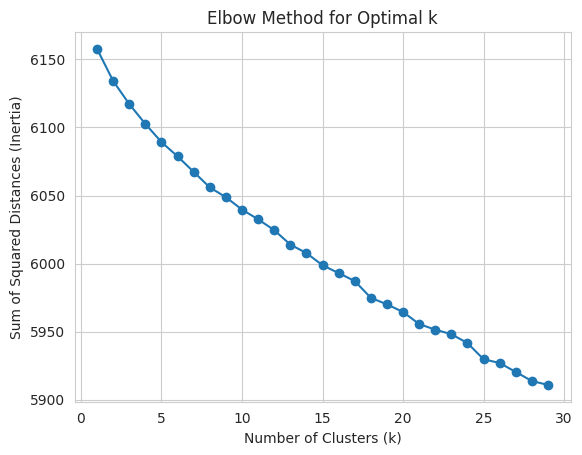

In [ ]:
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.datasets import make_blobs


k_values = range(1, 30)

inertia_values = []

# Run k-means for each k and calculate inertia
for k in k_values:
    kmeans = KMeans(n_clusters=k, n_init=10, random_state=42)
    kmeans.fit(X_lsa)
    inertia_values.append(kmeans.inertia_)

# Plot the elbow method
plt.plot(k_values, inertia_values, marker='o')
plt.title('Elbow Method for Optimal k')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Sum of Squared Distances (Inertia)')
plt.show()


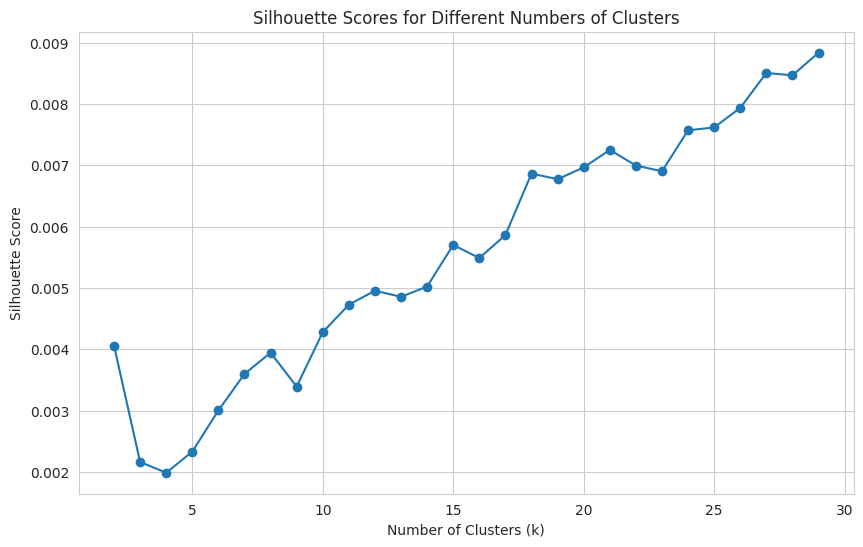

In [ ]:
from sklearn.metrics import silhouette_score
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

silhouette_scores = []

# Calculate silhouette score for each k
for k in range(2, 30):
    kmeans = KMeans(n_clusters=k, n_init=10, random_state=42)
    kmeans.fit(X_lsa)
    labels = kmeans.labels_
    score = silhouette_score(X_lsa, labels)
    silhouette_scores.append(score)

# Plotting the silhouette scores
plt.figure(figsize=(10, 6))
plt.plot(range(2, 30), silhouette_scores, marker='o')
plt.title('Silhouette Scores for Different Numbers of Clusters')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Silhouette Score')
plt.show()

Select k = 20 based on domain knowledge

In [ ]:
kmeans_LDA = KMeans(
    n_clusters=20,
    max_iter=100,
    n_init=10,
)

labels = kmeans_LDA.fit_predict(X_lsa)
df['cluster_k'] = labels

In [ ]:
df.head()

,isbn,title,subtitle,authors,publisher,publishedDate,description,pageCount,categories,language,CombinedText,cluster_h,cluster_k
0,0884115631,The Shepherd,NaN,Frederick Forsyth,NaN,1960-06-01,A pilot and his plane are saved by a mysteriou...,0,Fiction,en,shepherd frederick forsyth pilot plane save m...,4,2
1,0060175648,Identity,A Novel,Milan Kundera,Harper,1998-04-21,Milan Kundera's Identity translated from the F...,176,Fiction,en,ident novel milan kundera milan kundera ident ...,4,3
2,0394535383,Pillar of the Sky,A Novel,Cecelia Holland,Alfred a Knopf Incorporated,1985,"Two thousand years ago, at the site of Stonehe...",534,England,en,pillar sky novel cecelia holland two thousand ...,4,18
3,0843114401,Jingle Bear,NaN,Stephen Cosgrove,NaN,1985,When the other bears get ready to hibernate fo...,36,Bears,en,jingl bear stephen cosgrov bear get readi hib...,12,7
4,0451207408,The Adventurer,NaN,Jaclyn Reding,Signet Book,2002,"While attempting to return a mysterious, legen...",314,Fiction,en,adventur jaclyn rede attempt return mysteri l...,4,10


After a careful examination of the word clouds generated from the K-means algorithm clusters, it is evident that, despite the unimpressive results indicated by the elbow method and the silhouette scores, the clusters contain discernible topics and genres. Besides, some of these topics align with those identified by the hierarchical clustering method, suggesting that there are indeed meaningful patterns within the data that both clustering approaches are able to capture, regardless of the quantitative metrics implying otherwise.

CLUSTER NUMBER:  2


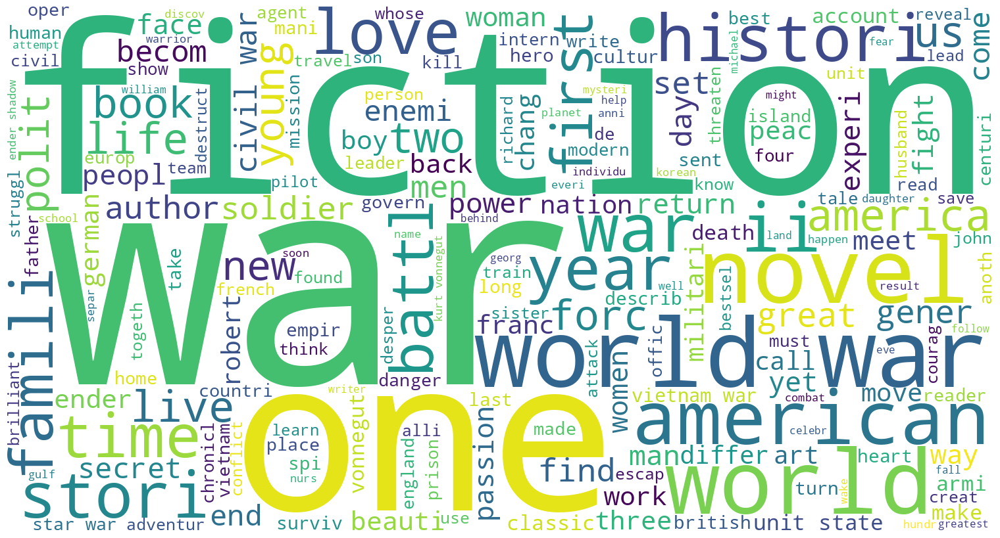

CLUSTER NUMBER:  3


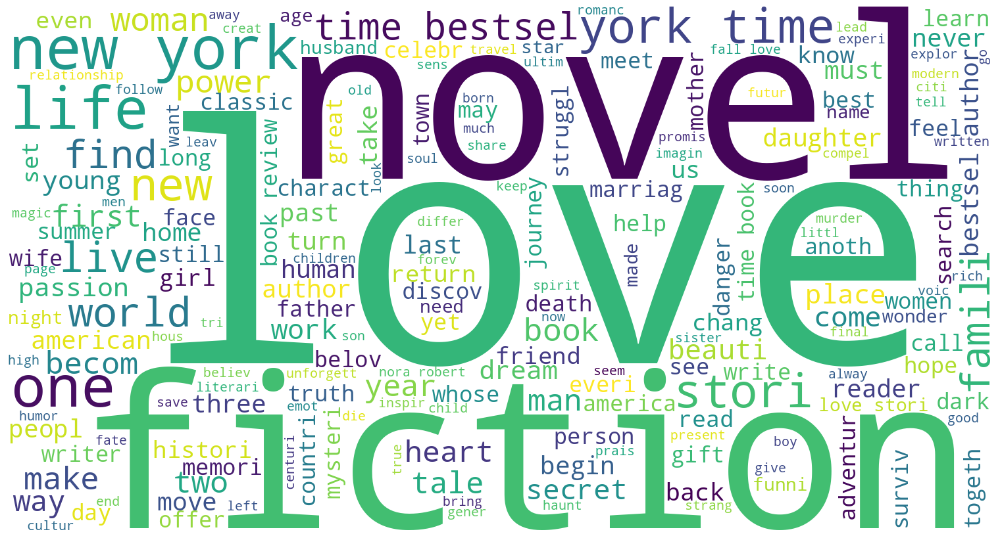

CLUSTER NUMBER:  18


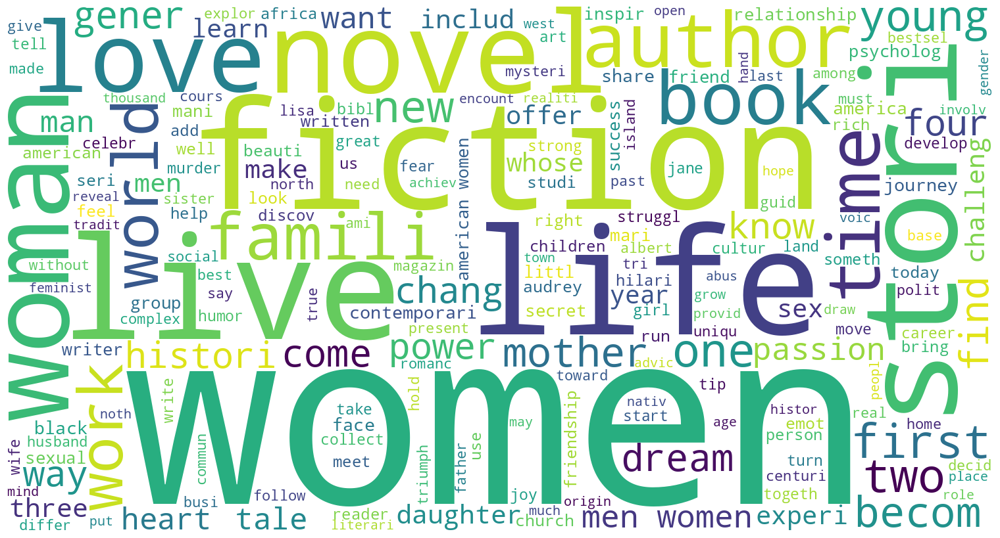

CLUSTER NUMBER:  7


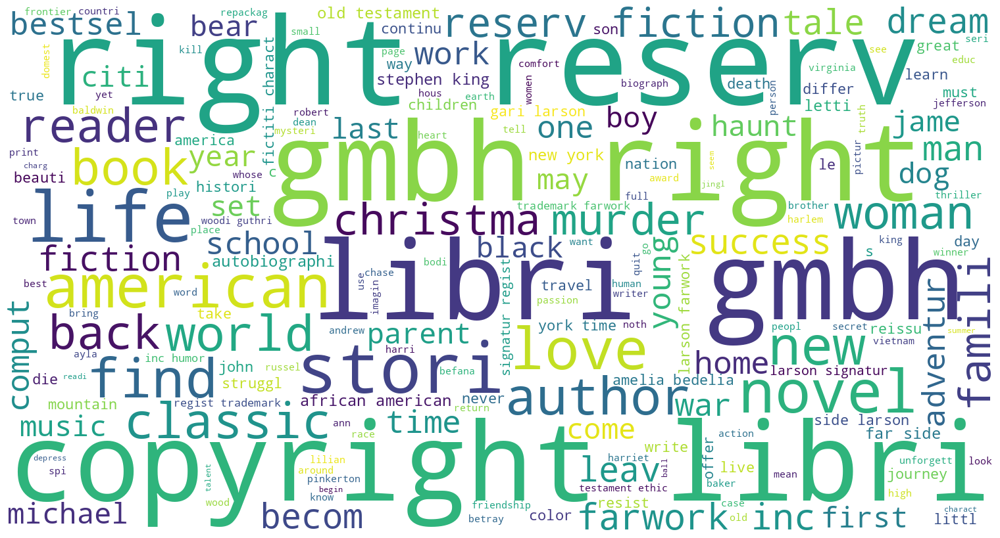

CLUSTER NUMBER:  10


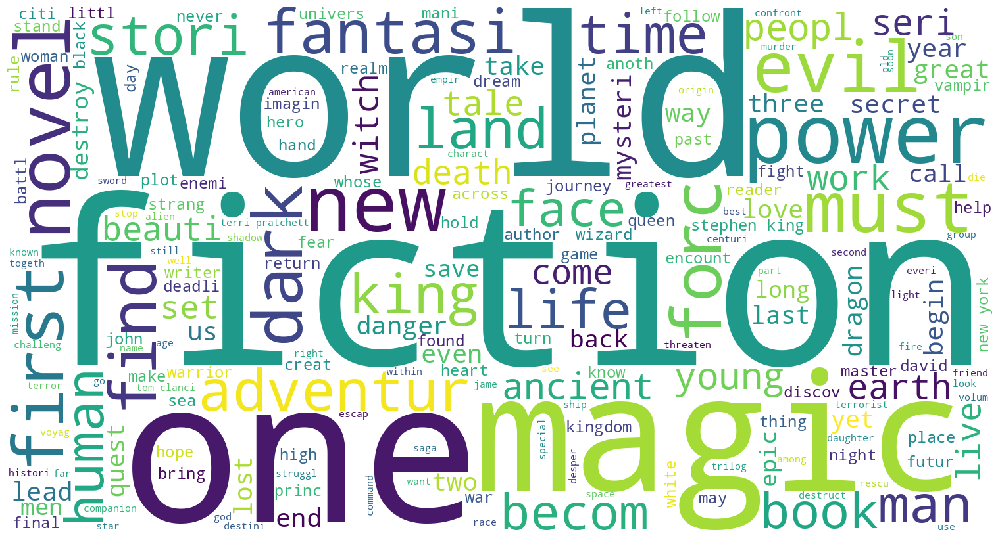

CLUSTER NUMBER:  14


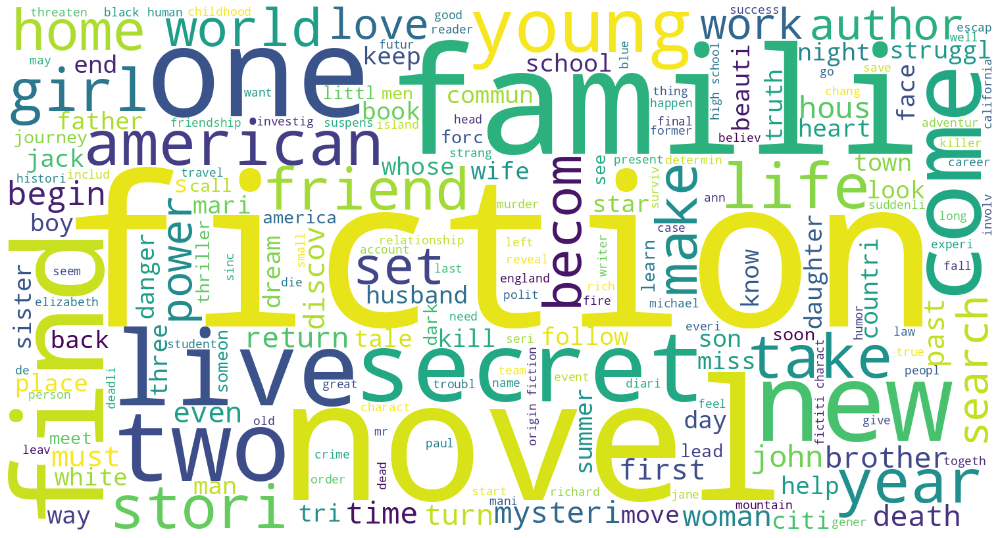

CLUSTER NUMBER:  12


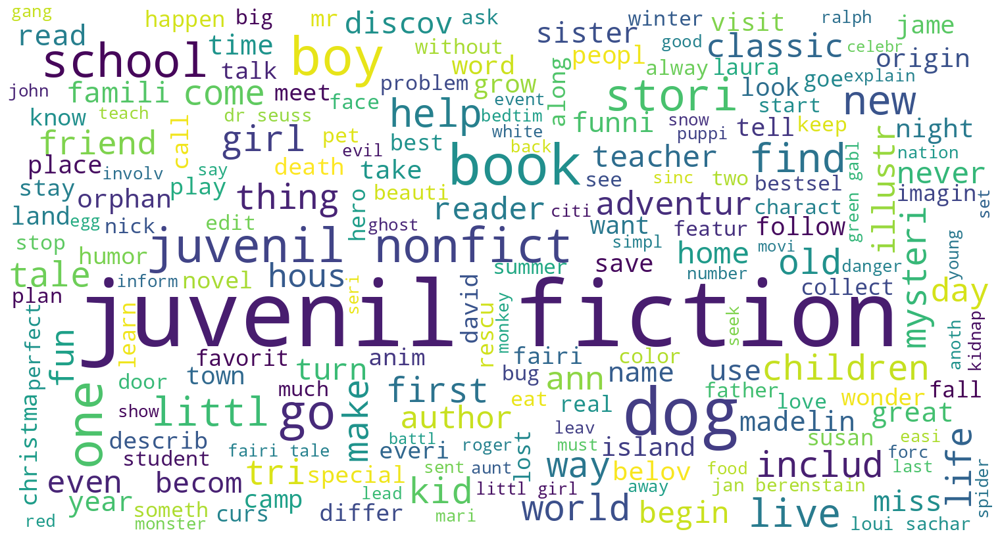

CLUSTER NUMBER:  13


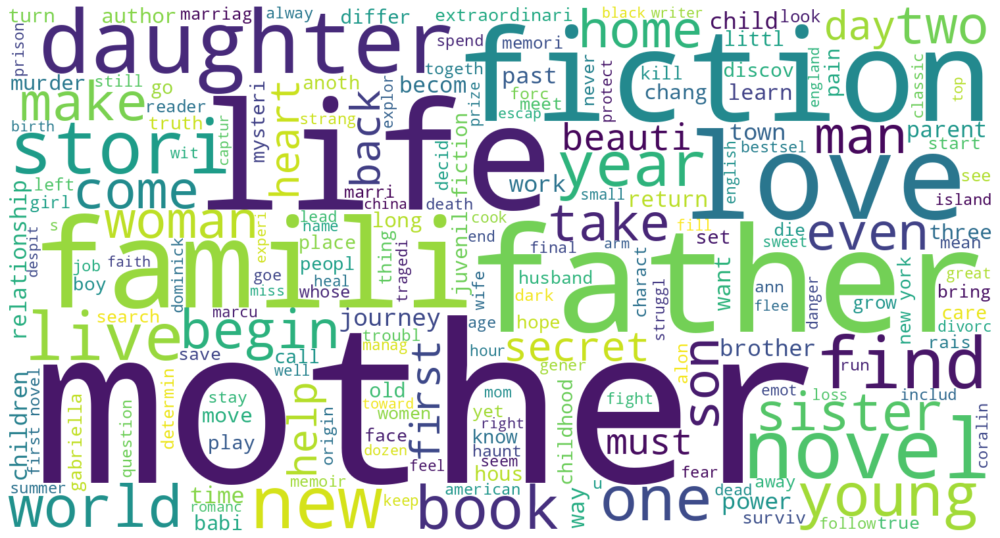

CLUSTER NUMBER:  17


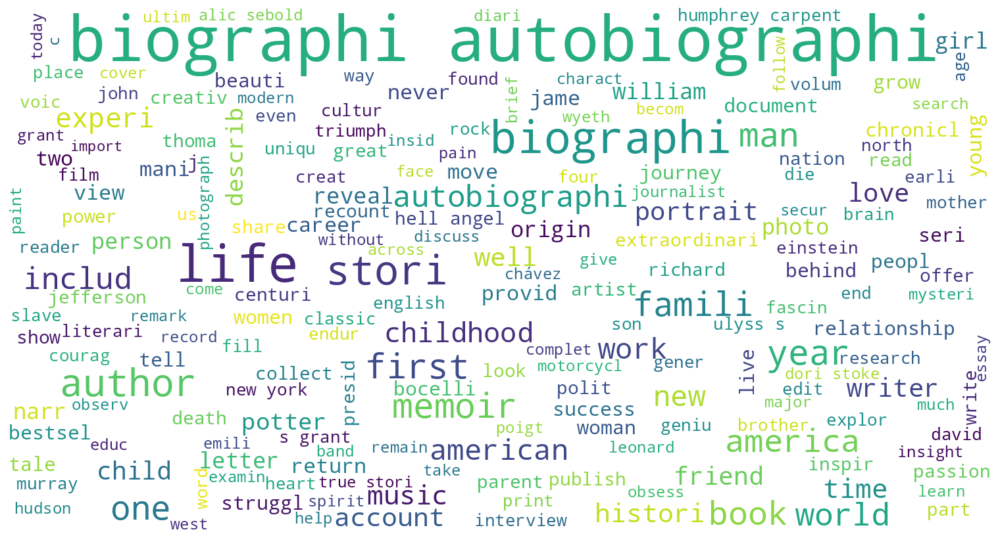

CLUSTER NUMBER:  1


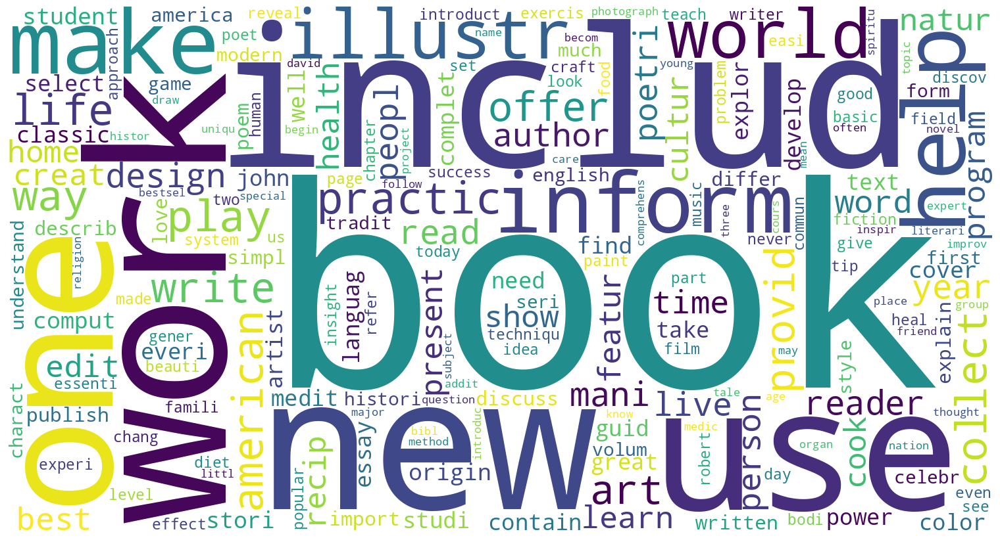

CLUSTER NUMBER:  6


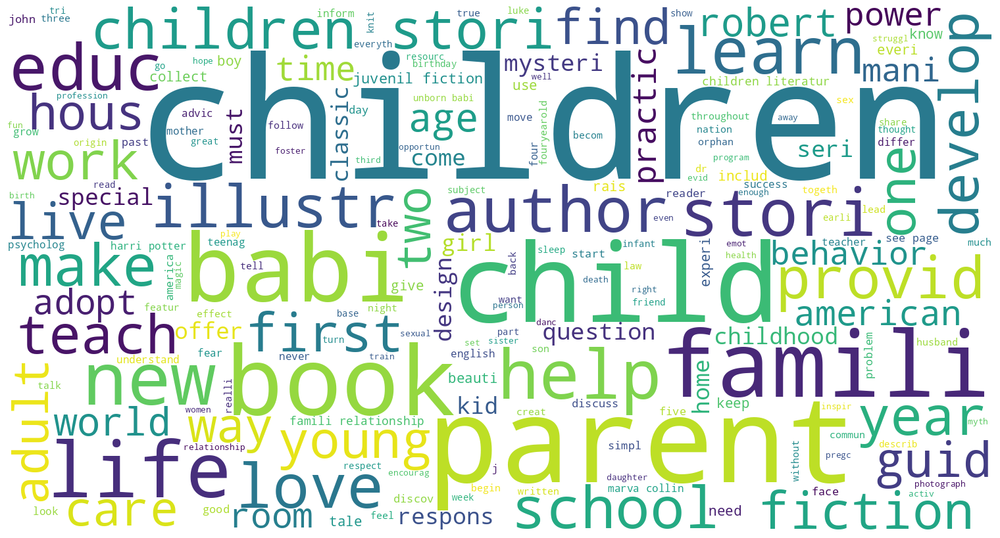

CLUSTER NUMBER:  8


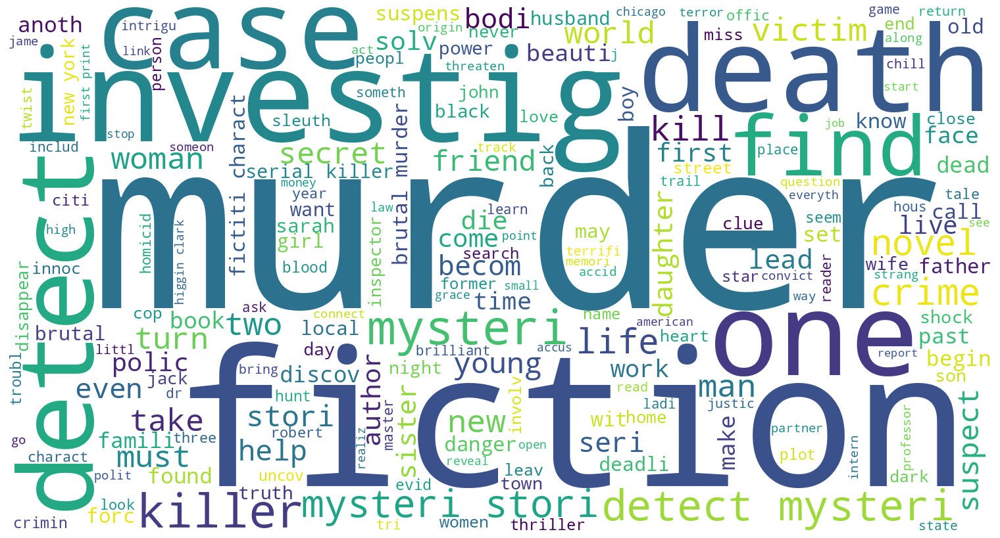

CLUSTER NUMBER:  5


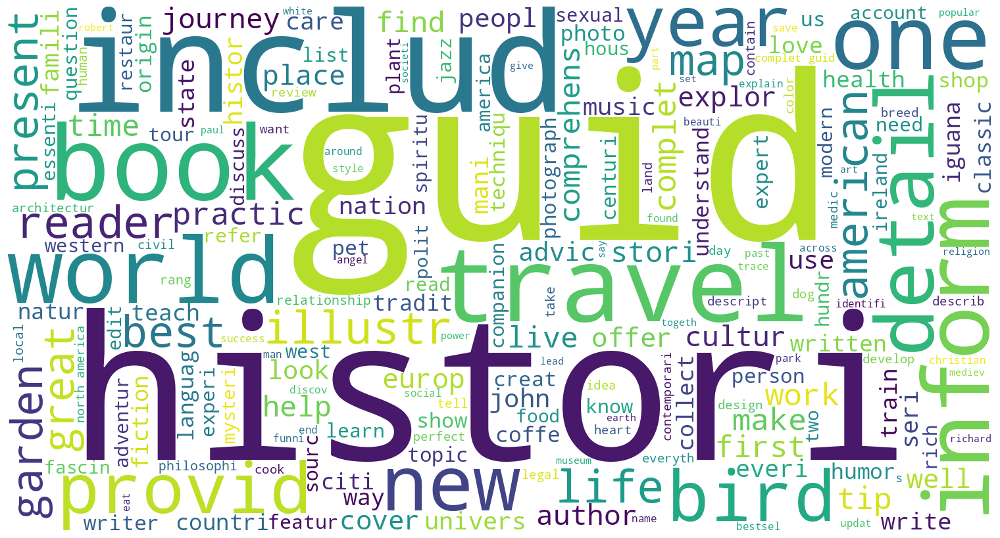

CLUSTER NUMBER:  9


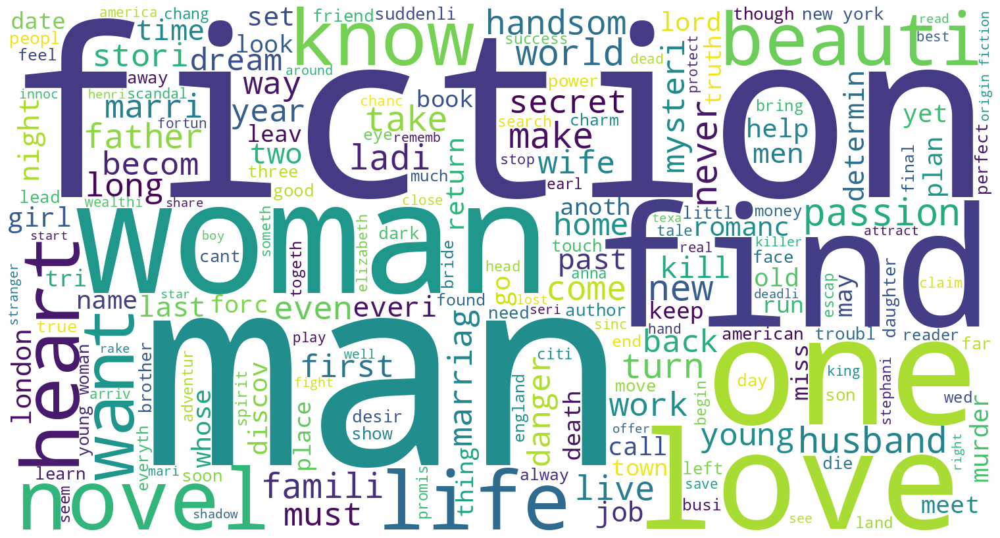

CLUSTER NUMBER:  19


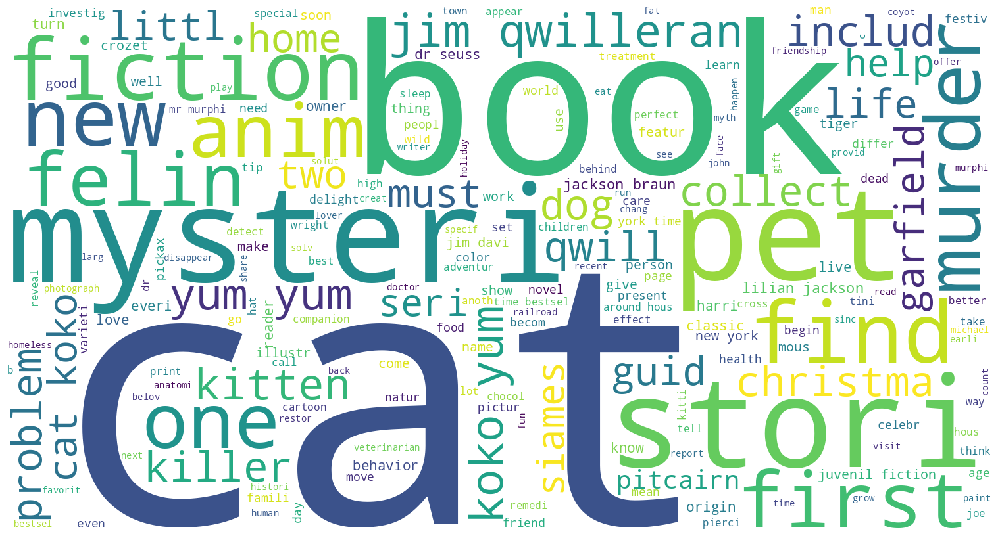

CLUSTER NUMBER:  11


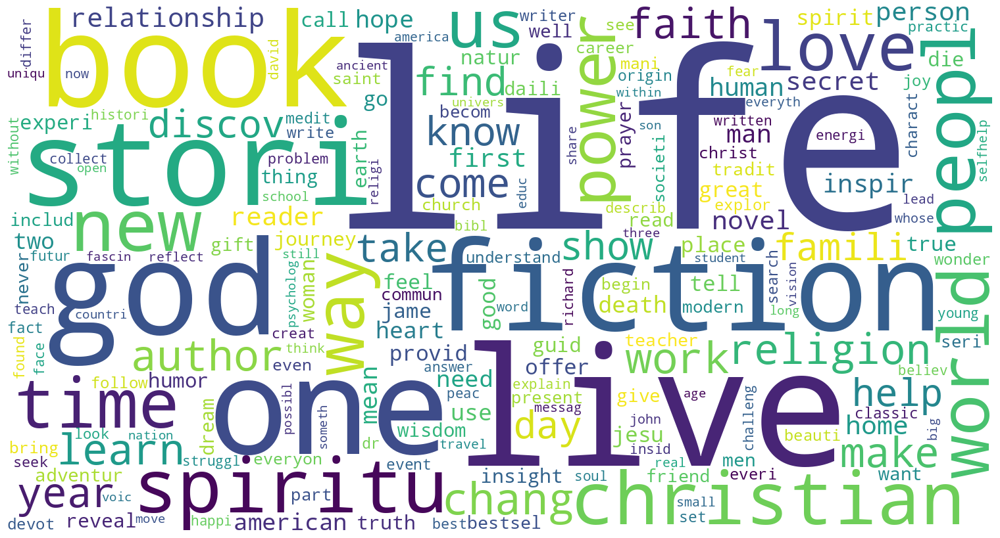

CLUSTER NUMBER:  4


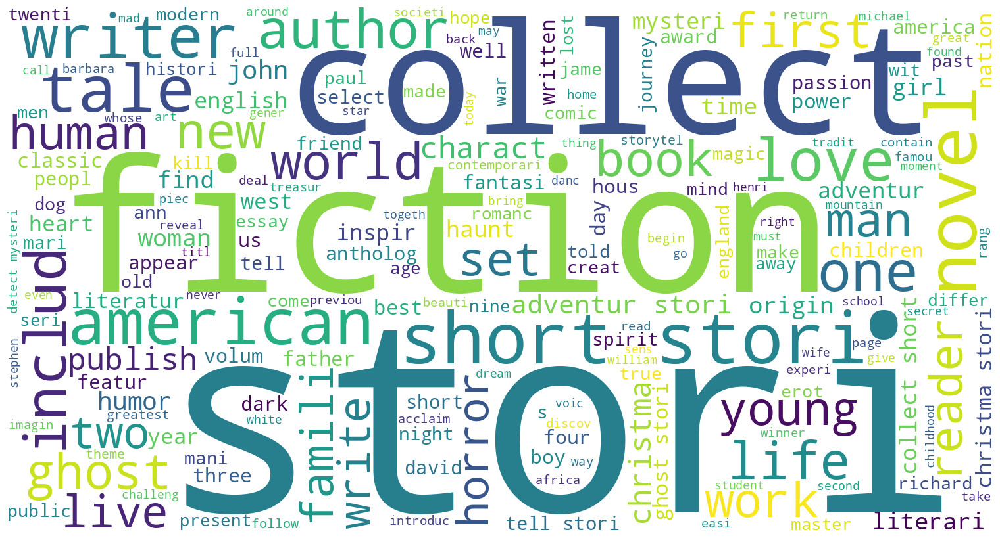

CLUSTER NUMBER:  16


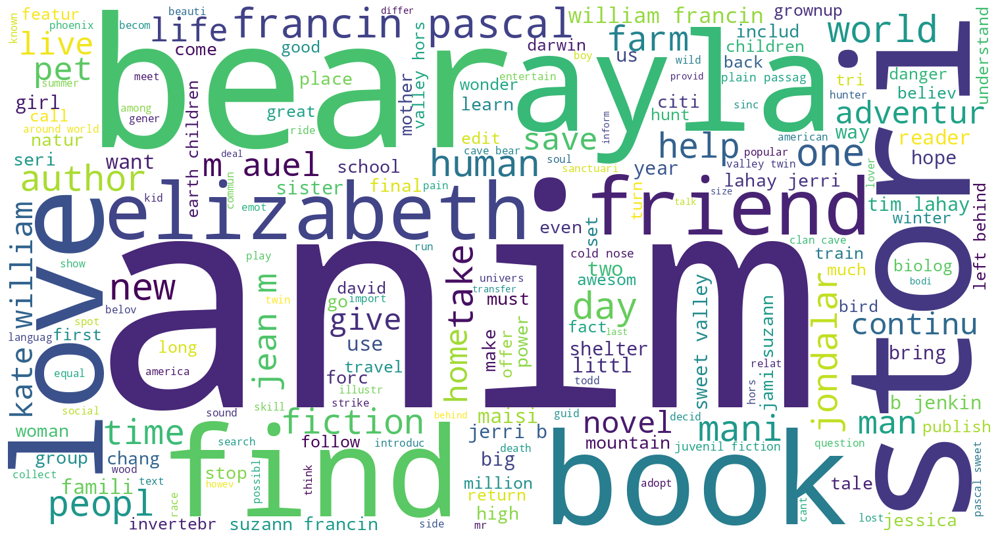

CLUSTER NUMBER:  0


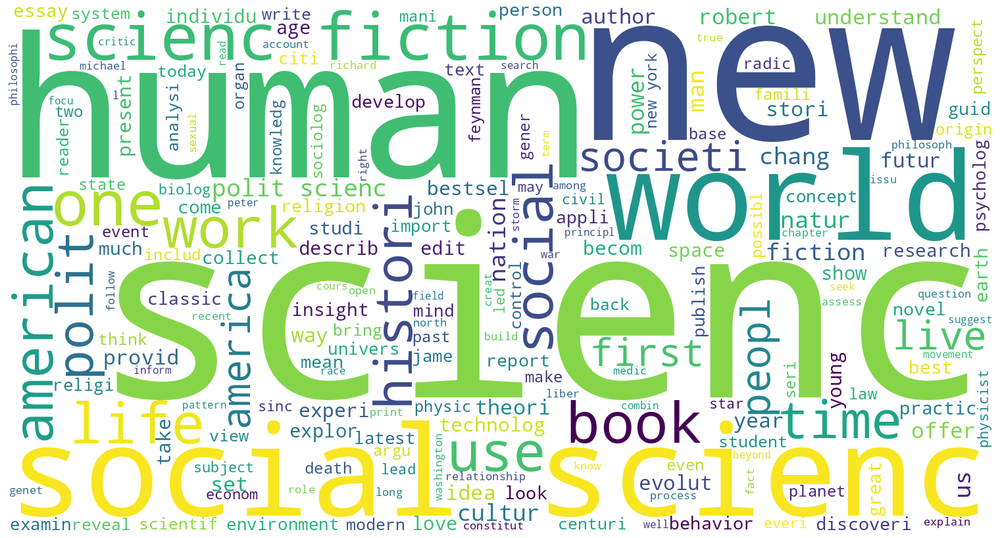

CLUSTER NUMBER:  15


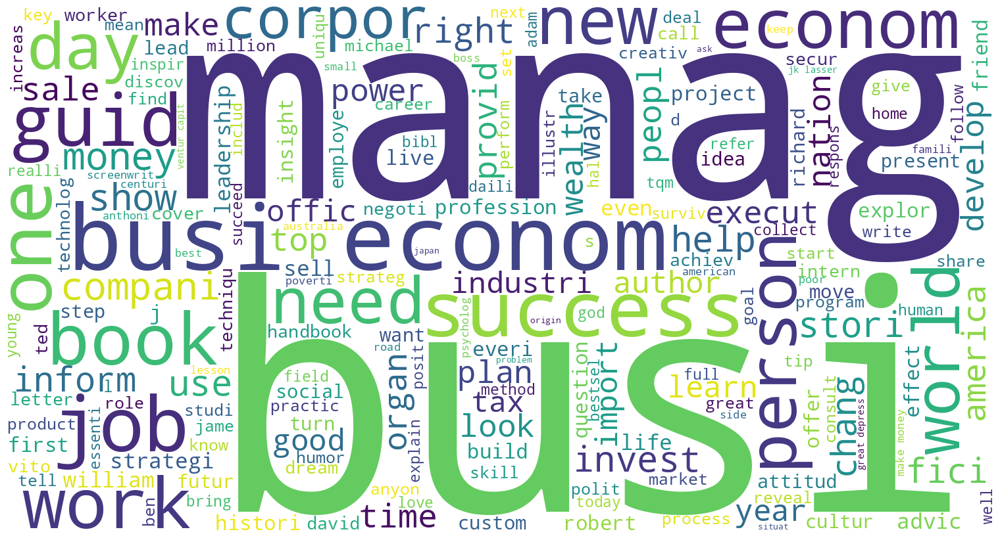

In [ ]:
# Get unique cluster labels
unique_clusters = df['cluster_k'].unique()

# Create a dictionary to store DataFrames for each cluster
cluster_dataframes = {}

# Split the DataFrame by cluster label
for cluster_label in unique_clusters:
    cluster_dataframes[cluster_label] = df[df['cluster_k'] == cluster_label]
    joined_genre = ' '.join(cluster_dataframes[cluster_label]['CombinedText'])
    print("CLUSTER NUMBER: ", cluster_label)
    create_wordcloud(joined_genre)

In [ ]:
cluster_distribution = df['cluster_k'].value_counts().sort_index()
print(cluster_distribution)


0      154
1      777
2      200
3      493
4      284
5      299
6      176
7       82
8      468
9      401
10     486
11     400
12     225
13     195
14    1099
15      98
16      96
17     125
18     147
19      68
Name: cluster_k, dtype: int64


## Recommender system

Finally, we use our clustering results to build a book recommender system, this system is designed to personalize recommendations for each user, focusing particularly on their highest-rated book, it uses the cosine similarity to find books that are similar to the user’s highest-rated book within the same cluster.
This way improves the relevance and accuracy of the recommendations,  aligning them closely with the user's demonstrated preferences.


In [ ]:
df_reviews.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 66082 entries, 0 to 66081
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   Unnamed: 0   66082 non-null  int64 
 1   User-ID      66082 non-null  int64 
 2   ISBN         66082 non-null  object
 3   Book-Rating  66082 non-null  int64 
dtypes: int64(3), object(1)
memory usage: 2.0+ MB


In [ ]:
from sklearn.metrics.pairwise import cosine_similarity

def recommend_books(user_id, df_reviews, df, tfidf_matrix):
    # Select all reviews for the specified user
    user_reviews = df_reviews[df_reviews['User-ID'] == user_id]

    # If the user has no reviews, return an empty list
    if user_reviews.empty:
        print(f"No reviews found for User ID {user_id}.")
        return []

    # Find the ISBN of the highest-rated book for the user
    highest_rated_isbn = user_reviews.loc[user_reviews['Book-Rating'].idxmax(), 'ISBN']

    print(df[df['isbn'] == highest_rated_isbn]['title'])

    # Find the index of the highest-rated ISBN in the book DataFrame
    index_of_highest_rated = df[df['isbn'] == highest_rated_isbn].index[0]

    # Assuming tfidf_matrix is your TF-IDF matrix
    tfidf_row_highest_rated = tfidf_matrix[index_of_highest_rated, :]

    # Calculate cosine similarity with all other books in the cluster
    similarities = cosine_similarity(tfidf_row_highest_rated.reshape(1, -1), tfidf_matrix)

    # Get the cluster of the highest-rated book
    cluster_of_highest_rated = df.loc[df["isbn"] == highest_rated_isbn, 'cluster_k'].values[0]

    # Mask out books not in the same cluster
    cluster_similarities = similarities[0, df['cluster_k'] == cluster_of_highest_rated]

    # Find the top 5 most similar books within the cluster
    top_similar_indexes = cluster_similarities.argsort()[-6:-1][::-1]

    # Filter out books that the user has already rated
    user_rated_books = set(user_reviews['ISBN'])
    recommended_books = []

    # Display the top 5 most similar and unrated books' titles
    print(f"Top 5 recommended books for User ID {user_id} (unrated):")
    for similar_index in top_similar_indexes:
        similar_isbn = df.loc[similar_index, 'isbn']
        if similar_isbn not in user_rated_books:
            similar_title = df.loc[similar_index, 'title']
            similar_author = df.loc[similar_index, 'authors']
            similar_genre = df.loc[similar_index, 'categories']
            recommended_books.append(similar_title)
            print(f'{similar_title}, {similar_author}, {similar_genre}')

    return recommended_books

In [ ]:
# Assuming your DataFrame is named df
random_user_id = df_reviews['User-ID'].sample(1, random_state=523).values[0]
print(random_user_id)
recommendations = recommend_books(random_user_id, df_reviews, df, tfidf)

145459
5978    Jurassic Park : [novel]
Name: title, dtype: object
Top 5 recommended books for User ID 145459 (unrated):
Fried by Jury, Claudia Bishop, Fiction
Lucky Jim, Kingsley Amis, College teachers
The Sacred Balance, David Suzuki, Amanda McConnell, Conservation of natural resources
Temporary Mistress, Susan Johnson, Fiction
The Power of a Praying Parent, Stormie Omartian, Devotional calendars


## Collaborative filtering

Collaborative filtering is a method used in recommendation systems to suggest items (like books) to users. It works by analyzing the preferences and behaviors of various users and then making recommendations based on similarities among them. There are two main types:

User-Based Filtering: This type makes recommendations based on the preferences of similar users. For instance, if two users have rated several books similarly, the system will recommend books liked by one user to the other. The similarity between users is calculated using methods like Pearson correlation or cosine similarity.

Item-Based Collaborative Filtering: Instead of focusing on user similarity, this method recommends items based on their similarity with items that the target user has already rated. It calculates the similarity between items (like books), so if a user likes a particular book, the system will recommend other books that are similar to it.

Collaborative filtering addresses the limitations of content-based systems, which only suggest items similar to what the user has already liked, and can't capture diverse tastes or provide cross-genre recommendations. It also adds a personal 'taste' to recommendations, unlike content-based systems that offer the same suggestions to everyone.

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
df_sim = df.copy()
df_sim = df_sim[df_sim['Book-Rating']!=0]
df_similarity=df_sim.copy()
df_similarity = df_similarity.astype(str)
df_similarity.drop('Unnamed: 0', axis=1, inplace=True)
df_similarity['ISBN'] = df_similarity['ISBN'].str.replace('[^a-zA-Z0-9]', '', regex=True)
#df_similarity[df_similarity['User-ID']=='11676']
df_similarity.head()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,User-ID,ISBN,Book-Rating
0,16,0345402871,9
1,17,0425099148,7
2,26,0449005615,9
3,26,0446310786,10
4,39,0553582909,8


## Selected users analysis

In addition to the overall accuracy of SVD model in the entire dataset and recommending the top 10 best books for a user, we plan to take a sample of users, predict their scores, and then compare these predictions with the actual scores.

Before we remove these selected users from the main dataset, we must ensure that the collaborative filtering model has sufficient information about the books, based on ratings from other users, which the selected users have also rated.

In [ ]:
#Users and their number of rating score
def user_books(users):
    user_books_dict = {}
    selected_users = df_similarity[df_similarity['User-ID'].isin(users)]
    for user in users:
        user_books_dict[user] = selected_users[selected_users['User-ID'] == user]['ISBN'].to_list()
    return user_books_dict

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
users = ['15497','23768','11676','6242','6073']
user_books_dict = user_books(users)
value_counts = {}
value_counts = {key: len(values) for key, values in user_books_dict.items()}
value_counts

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


{'15497': 1, '23768': 26, '11676': 752, '6242': 33, '6073': 15}

In [ ]:
# table without the selected users
df_no_selected_users = df_similarity[~df_similarity['User-ID'].isin(user_books_dict.keys())]

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
len(df_similarity) - len(df_no_selected_users)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


827

In [ ]:
# Counts of selected user's ISBN
item_frequency = {}

for key in user_books_dict:
    for item in user_books_dict[key]:
        if item in item_frequency:
            item_frequency[item] += 1
        else:
            item_frequency[item] = 1

print(item_frequency)

{'0140293248': 3, '0805063897': 1, '1400031346': 2, '0684857820': 2, '0743418174': 2, '0060934417': 2, '0060931418': 1, '0060929871': 1, '0060198125': 1, '1580173128': 1, '0375413634': 1, '0380718340': 2, '038548951X': 2, '0316666343': 2, '0156505150': 1, '0312265859': 2, '0394800184': 2, '0671880187': 1, '0671740504': 1, '0670869902': 1, '0553109588': 2, '0394800133': 2, '0516098020': 1, '0440226198': 1, '039480029X': 1, '0394800206': 1, '0440204194': 1, '0805054073': 1, '0807553670': 1, '0812502124': 1, '0812550706': 1, '0786861347': 1, '0786866462': 1, '0786867175': 1, '0786885688': 1, '0786881852': 1, '0786868716': 1, '0786867906': 1, '0786889667': 1, '0804105820': 1, '080410753X': 1, '0804119708': 1, '0804115761': 1, '0804114986': 1, '0804111359': 1, '080411109X': 1, '0804108749': 1, '0802130208': 2, '067697175X': 1, '0671888587': 1, '0679425241': 1, '0679432477': 1, '0679407596': 1, '0671750402': 1, '0671732277': 1, '0671867091': 1, '0671873199': 1, '0671873202': 1, '0671789422':

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
value_counts = df_no_selected_users['ISBN'].value_counts()
counts_users_books = {}
for user, books in user_books_dict.items():
    user_book_counts = value_counts[value_counts.index.isin(books)]
    counts_users_books[user] = user_book_counts.to_dict()
    #print(f"Items for {key}: {items}")
counts_users_books

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


{'15497': {'0140293248': 162},
 '23768': {'0316666343': 705,
  '0743418174': 234,
  '0060934417': 157,
  '0805063897': 133,
  '0380718340': 78,
  '0060929871': 68,
  '0312265859': 50,
  '1400031346': 46,
  '0671880187': 43,
  '0375413634': 40,
  '0684857820': 36,
  '038548951X': 33,
  '0060931418': 32,
  '0440204194': 28,
  '0670869902': 24,
  '039480029X': 18,
  '0394800133': 17,
  '0553109588': 14,
  '0394800206': 12,
  '0440226198': 11,
  '0060198125': 11,
  '0394800184': 10,
  '0671740504': 4,
  '0156505150': 2},
 '11676': {'0316666343': 705,
  '0971880107': 580,
  '0385504209': 486,
  '0312195516': 381,
  '059035342X': 312,
  '044023722X': 280,
  '067976402X': 254,
  '0786868716': 241,
  '0743418174': 234,
  '0345337662': 229,
  '0375727345': 228,
  '0312278586': 225,
  '0440226430': 212,
  '044021145X': 207,
  '0671003755': 206,
  '0446605239': 205,
  '0345370775': 199,
  '0385484518': 199,
  '0440241073': 199,
  '0345417623': 194,
  '0345361792': 180,
  '0446610038': 176,
  '044

A large number of users (without including the selected users) have rated the same ISBN (book codes) as those chosen by the the selected users, across all the dataset. This ensures that the model has ratings for the user's ISBN from other user's ratings, thereby we reduce the risk of a "cold start" or uncertainty.

In [ ]:
test = {}
for key in counts_users_books:
    # Keep only the first three items for each key
    test[key] = dict(list(counts_users_books[key].items())[:5])
test

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


{'15497': {'0140293248': 162},
 '23768': {'0316666343': 705,
  '0743418174': 234,
  '0060934417': 157,
  '0805063897': 133,
  '0380718340': 78},
 '11676': {'0316666343': 705,
  '0971880107': 580,
  '0385504209': 486,
  '0312195516': 381,
  '059035342X': 312},
 '6242': {'0312195516': 381,
  '067976402X': 254,
  '0312291639': 165,
  '0140293248': 162,
  '0060934417': 157},
 '6073': {'0440226430': 212,
  '0440211727': 193,
  '0440214041': 173,
  '0802130208': 67,
  '0679723161': 49}}

In [ ]:
# We will remove the ratings of these users' books from our dataset.
# This allows us to later predict their ratings and compare them with the actual scores.
to_remove = {
    '15497': ['0140293248'],
    '23768': ['0316666343', '0743418174', '0060934417'],
    '11676': ['0316666343', '0971880107', '0385504209'],
    '6242': ['0312195516', '067976402X', '0312291639'],
    '6073': ['0440226430', '0440211727', '0440214041']}

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
#shows the rating of the users before remove its rows in df_similarity
def match_row(row):
    user_id = row['User-ID']
    isbn = row['ISBN']
    return user_id in to_remove and isbn in to_remove[user_id]

df_to_compare = df_similarity[df_similarity.apply(match_row, axis=1)]
df_to_compare

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,User-ID,ISBN,Book-Rating
1028,6073,0440226430,6
1029,6073,0440214041,5
1030,6073,0440211727,6
1065,6242,067976402X,8
1077,6242,0312195516,7
1079,6242,0312291639,5
2719,11676,0971880107,6
2843,11676,0316666343,5
3125,11676,0385504209,9
3910,15497,0140293248,6


Remove some ISBN's of the selected user from the main dataset, to later use the trained SVD model to predict their rating score and compare to the actual ones.

In [ ]:
for user_id, isbns in to_remove.items():
    for isbn in isbns:
        mask = ~((df_similarity['User-ID'] == user_id) & (df_similarity['ISBN'] == isbn))
        df_similarity = df_similarity[mask]



/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
len(df_similarity)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


66069

In [ ]:
print(df['Book-Rating'].describe())

count    66082.000000
mean         7.781030
std          1.792506
min          1.000000
25%          7.000000
50%          8.000000
75%          9.000000
max         10.000000
Name: Book-Rating, dtype: float64


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


## COLLABORATIVE FILTERING

Collaborative filtering faces challenges like scalability (the system's performance as the number of users and items grows) and sparsity (the issue of having too many items and not enough ratings). To tackle these, we are going to use Single Value Decomposition (SVD), which reduces the dimensionality of the problem and help in understanding the relationships between users and items by mapping them into a 'latent space'. This approach turns recommendation into an optimization problem, focusing on predicting ratings as accurately as possible.

In [ ]:
from surprise import Dataset, Reader, SVD, accuracy
from surprise.model_selection import cross_validate

# Assuming your dataset is in a DataFrame df with columns 'userid', 'isbn', 'rating'
reader = Reader(rating_scale=(1, 10))
data = Dataset.load_from_df(df_similarity[['User-ID', 'ISBN', 'Book-Rating']], reader)
#data.split(n_folds=5)
algo = SVD()
cross_validate(algo, data, measures=['RMSE', 'MAE'],cv=5,verbose=True)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Evaluating RMSE, MAE of algorithm SVD on 5 split(s).

                  Fold 1  Fold 2  Fold 3  Fold 4  Fold 5  Mean    Std     
RMSE (testset)    1.6518  1.6396  1.6613  1.6342  1.6398  1.6454  0.0098  
MAE (testset)     1.2841  1.2833  1.2865  1.2727  1.2702  1.2794  0.0066  
Fit time          3.37    3.45    1.24    1.33    1.21    2.12    1.05    
Test time         0.17    0.14    0.10    0.09    0.08    0.11    0.03    


{'test_rmse': array([1.65183358, 1.63958403, 1.66132671, 1.63423684, 1.63980307]),
 'test_mae': array([1.28413436, 1.28331042, 1.28654852, 1.27268703, 1.27022058]),
 'fit_time': (3.366396903991699,
  3.4462506771087646,
  1.242121696472168,
  1.3259177207946777,
  1.206843376159668),
 'test_time': (0.1653432846069336,
  0.14249110221862793,
  0.09584164619445801,
  0.0865316390991211,
  0.08172607421875)}

Using SVD method in our dataset, the RMSE is around 1.65 points. Ideally this should be less than 1. However, the full dataset was reduced to 6600 samples due to computational limitations, ff the dataset has limited user rating score or if only a few users rate a book, SVD, like other collaborative filtering methods, struggles to predict the scores accurately. Therefore, it often bases its predictions around the mean, which can be somewhat distant from the actual values, as is the case here. However, an RMSE error prediction of 1.65, while not ideal, is not overly high.

The SVD model deviates from the predicted to the actual value by around 1.65 points. Ideally, the RMSE (Root Mean Square Error) value should be less than 1. Due to computational limitations, the full dataset of books and ratings scores was reduced for the other algorithms. Collaborative filtering models, including SVD, heavily rely on available data to make accurate recommendations to users. If the dataset has limited user rating score or if only a few users rate a book,SVD, like other collaborative filtering methods, struggles to predict the scores accurately. Therefore, it often bases its predictions around the mean, which can be somewhat distant from the actual values, as is the case here. However, an RMSE error prediction of 1.65, while not ideal, is not overly high. At the end of the notebook, we will compare the actual and predicted scores of some users using the SVD."

In [ ]:
#Take all data as trainset
dataset = data.build_full_trainset()
algo = SVD()
algo.fit(dataset)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
# give user id, trained dataset, train dataset, df all user rating
def get_top_recommendations(user_id):
    # Convert raw user ID to internal user ID
    try:
        internal_user_id = dataset.to_inner_uid(str(user_id))
    except ValueError:
        print(f"User ID {user_id} not found in the dataset.")
        return []

    # Get the set of items (books) that the user has already rated
    internal_user_ratings = set([j for (j, _) in dataset.ur[internal_user_id]])
    user_ratings_isbn = set([dataset.to_raw_iid(iid) for iid in internal_user_ratings])

    # Get the set of all books the user hasn't rated
    all_books = set(df_similarity['ISBN'])
    unrated_books = all_books - user_ratings_isbn

    # Predict ratings for all unrated books
    predicted_ratings = []
    for book_isbn in unrated_books:
        # Predict rating for each unrated book
        prediction = algo.predict(str(user_id), book_isbn)
        predicted_ratings.append((book_isbn, prediction.est))

    # Sort the predictions by estimated rating in descending order
    predicted_ratings.sort(key=lambda x: x[1], reverse=True)

    top_10_recommendations = predicted_ratings[:10]
    return top_10_recommendations

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
user_id = 11676
#  '15497', '23768', '6242', 6073'
top_10_books = get_top_recommendations(user_id)

for isbn, rating in top_10_books:
    print(f"ISBN: {isbn}, Predicted Rating: {rating}")

#If the user in question has very few ratings, or if the items to be predicted have been rated by very few users,
# the algorithm might struggle to find relevant neighbors, leading to average-based predictions.

ISBN: 0345339681, Predicted Rating: 10
ISBN: 0385504209, Predicted Rating: 9.990533014021535
ISBN: 006017143X, Predicted Rating: 9.874532193518874
ISBN: 0345339711, Predicted Rating: 9.591714460334407
ISBN: 0836218051, Predicted Rating: 9.580984765926663
ISBN: 0439136350, Predicted Rating: 9.53964606411394
ISBN: 1558744630, Predicted Rating: 9.533651543961536
ISBN: 0553270931, Predicted Rating: 9.50898651097769
ISBN: 0515134481, Predicted Rating: 9.507747849979072
ISBN: 0446301582, Predicted Rating: 9.507121930876439


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
df_bookss = df_books
df_bookss = df_bookss.astype(str)
df_bookss.head()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,isbn,title,subtitle,authors,publisher,publishedDate,description,pageCount,categories,language
0,0884115631,The Shepherd,nan,Frederick Forsyth,nan,1960-06-01,A pilot and his plane are saved by a mysteriou...,0,Fiction,en
1,0060175648,Identity,A Novel,Milan Kundera,Harper,1998-04-21,Milan Kundera's Identity translated from the F...,176,Fiction,en
2,0394535383,Pillar of the Sky,A Novel,Cecelia Holland,Alfred a Knopf Incorporated,1985,"Two thousand years ago, at the site of Stonehe...",534,England,en
3,0843114401,Jingle Bear,nan,Stephen Cosgrove,nan,1985,When the other bears get ready to hibernate fo...,36,Bears,en
4,0451207408,The Adventurer,nan,Jaclyn Reding,Signet Book,2002,"While attempting to return a mysterious, legen...",314,Fiction,en


In [ ]:
#Actual rated book of user: 11676
a_user = df_similarity[df_similarity['User-ID'] == '11676']
a_user_books = df_bookss[df_bookss['isbn'].isin(a_user['ISBN'])]
a_user_books.head()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,isbn,title,subtitle,authors,publisher,publishedDate,description,pageCount,categories,language
40,0440176484,Secrets,A Novel,Danielle Steel,Dell,1986-10-01,"Danielle Steel, America’s number-one best-sell...",449,Fiction,en
45,038548951X,Sister of My Heart,A Novel,Chitra Banerjee Divakaruni,Anchor,2000-01-18,From the award-winning author of Mistress of S...,340,Fiction,en
70,0394900901,The Bears' Christmas,nan,"Stan Berenstain, Jan Berenstain",Random House Books for Young Readers,1970,Father Bear tries to show his son how to use t...,59,Juvenile Fiction,en
71,0439083699,Franklin's Neighborhood,nan,"Sharon Jennings, Paulette Bourgeois",Scholastic,1999,"For a school project, Franklin is asked to dra...",32,Juvenile Fiction,en
129,0842342702,Left Behind,A Novel of the Earth's Last Days,"Tim LaHaye, Jerry B. Jenkins",nan,1998,After millions of people around the world vani...,360,FICTION,en


In [ ]:
# Extract ISBNs from the recommendations
recommended_isbns = [isbn for isbn, _ in top_10_books]

# Filter the books DataFrame to only include recommended books
recommended_books_df = df_books[df_books['isbn'].isin(recommended_isbns)]

recommended_books_df

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,isbn,title,subtitle,authors,publisher,publishedDate,description,pageCount,categories,language
196,0553270931,Still Life with Woodpecker,NaN,Tom Robbins,Bantam,1980,A sort of love story revealing the purpose of ...,292,Fiction,en
5054,006017143X,The Night Listener,A Novel,Armistead Maupin,Harper,2000-09-19,Here is the much-anticipated new work from one...,116,Fiction,en
5189,0515134481,Circus of the Damned,"An Anita Blake, Vampire Hunter Novel",Laurell K. Hamilton,Penguin,2002-09-24,When a powerful centuries-old vampire hits Ani...,340,Fiction,en
5257,0345339711,The Two Towers,The Lord of the Rings: Part Two,J.R.R. Tolkien,Del Rey,1986-08-12,The middle novel in The Lord of the Rings—the ...,417,Fiction,en
5598,0446301582,Word of Honor,NaN,Nelson DeMille,Grand Central Publishing,1987-03-01,Read the gripping story of a Vietnam vet whose...,756,Fiction,en
5784,0345339681,The Hobbit,The Enchanting Prelude to The Lord of the Rings,J.R.R. Tolkien,Del Rey,1986-07-12,The stirring adventure that begins The Lord of...,322,Fiction,en
5832,0836218051,The Essential Calvin And Hobbes,NaN,Bill Watterson,Andrews McMeel Publishing,1988,The Essential Calvin and Hobbes is an over-siz...,264,Humor,en
5961,0385504209,The Da Vinci Code,NaN,Dan Brown,Doubleday,2003,Harvard symbologist Robert Langdon and French ...,472,Fiction,en
6008,0439136350,Harry Potter,The Complete Series,J. K. Rowling,NaN,NaN,During his third year at Hogwarts School for w...,435,Bildungsromans,en
6120,1558744630,Chicken Soup for the Teenage Soul,"101 Stories of Life, Love and Learning","Jack Canfield, Mark Victor Hansen, Kimberly Ki...",Chicken Soup for the Soul,1997,"101 stories of life, love, and learning.",382,Christian life,en


User 11676 rated multiple books, recommendated many fiction books, the model also recommends many multiple books

## Selected users: Predict rating score

In [ ]:
predicted_ratings = []

# Iterate over each row in the DataFrame
for index, row in df_to_compare.iterrows():
    user_id = row['User-ID']
    isbn = row['ISBN']

    # Predict the rating
    prediction = algo.predict(str(user_id), str(isbn))
    predicted_ratings.append(prediction.est)

df_to_compare['predicted bookRating'] = predicted_ratings

df_to_compare

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,User-ID,ISBN,Book-Rating,predicted bookRating
1028,6073,0440226430,6,8.173271
1029,6073,0440214041,5,8.620667
1030,6073,0440211727,6,8.889222
1065,6242,067976402X,8,6.028799
1077,6242,0312195516,7,5.582681
1079,6242,0312291639,5,5.886632
2719,11676,0971880107,6,5.268219
2843,11676,0316666343,5,9.479094
3125,11676,0385504209,9,9.990533
3910,15497,0140293248,6,6.956833


Apart from the RMSE value, we analysed the rating score on a sample users. The selected user were estracted from the dataset to predict their rating scores. We found differences between actual and predicted book valuations. Some predictions were quite close, as in the case of User 23768 (actual 8, predicted 7.90), but others were not, as in the case of User 6073 (actual 5, predicted 8.62). This shows that our model can guess user preferences to some extent, but does not always get it right.